<a href="https://colab.research.google.com/github/Ehsanahmadi1400/SemanticSegmentation/blob/main/SolarPanelsProject_PV08_Last.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:

# echo "# semanticSegmentation" >> README.md
# git init
# git add README.md
# git commit -m "first commit"
# git branch -M main
# git remote add origin https://github.com/Ehsanahmadi1400/semanticSegmentation.git
# git push -u origin main

<font color = 'dark green'> Description: Solar panel detection, using Semantic Segmentation

> Indented block


****


**Dataset:** Multi-resolution dataset for photovoltaic panel segmentation from satellite and aerial imagery

**Dataset Link:** https://essd.copernicus.org/articles/13/5389/2021/

**Model architechture:** UNet with MobilenetV2 as its base model


****


In [ ]:
from google.colab import drive # In order to google Drive
drive.mount('/content/drive')

Mounted at /content/drive


**Installations in case**

In [ ]:
!pip install -q git+https://github.com/tensorflow/examples.git  # Required for pix2pix usage

  Preparing metadata (setup.py) ... done


In [ ]:
# In case you need to unrar dataset, consider to place correct paths herunder
%cd /content/drive/MyDrive
# !unrar x '/content/drive/MyDrive/ItoSoftProject/images_PV08.rar' '/content/drive/MyDrive/ItoSoftProject/'
!unrar x '/content/drive/MyDrive/ItoSoftProject/labels_PV08.rar' '/content/drive/MyDrive/ItoSoftProject/'

**Copy dataset from gdrive to colab space**

In [ ]:
# copy data from gdrive to colab
import shutil

# Define source and destination paths
source_folder = '/content/drive/MyDrive/ItoSoftProject/labels_PV08'
destination_folder = '/content/labels_PV08'

# Copy the file
shutil.copytree(source_folder, destination_folder)

'/content/labels_PV08'

**Import required Libraries**

In [ ]:
import os
import cv2
import tqdm
import numpy as np
from PIL import Image
import urllib.request
import tensorflow as tf
import matplotlib as mpl
from tensorflow import keras
from keras.models import Model
import matplotlib.pyplot as plt
from keras.optimizers import Adam
from keras.models import load_model
from keras.applications.vgg16 import VGG16
from keras.applications import MobileNetV2
from sklearn.model_selection import train_test_split
from tensorflow_examples.models.pix2pix import pix2pix
from keras.losses import SparseCategoricalCrossentropy
from keras.layers import Input, Conv2D, MaxPooling2D, Dropout, Conv2DTranspose, Concatenate, concatenate, UpSampling2D

In [ ]:
# Declare data path
images_path = "/content/images_PV08"
masks_path = "/content/labels_PV08"

In [ ]:
# Coverting all the classes of dataset into two classes
OUTPUT_CHANNELS = 2
convs = {0: 0, 11: 1, 12: 1}

**Preprocessing functions**

In [ ]:
def standardize(x):
    x = np.array(x, dtype='float64')
    x -= np.min(x)
    x /= np.percentile(x, 98)
    x[x > 1] = 1
    return x

def preprocessing(img):
    image = np.array(img)
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    image = np.zeros_like(image)
    image[:,:,0] = gray
    image[:,:,1] = gray
    image[:,:,2] = gray
    image = standardize(image)
    return image

In [ ]:
# # In case extra files among the images
# # They could be simply identified and deleted
# %cd /content/images_PV08
# print(len(os.listdir(os.getcwd())))

# !rm desktop.ini

In [ ]:
# Creating lists of input data
images_paths = []
masks_paths  = []

for imgname in os.listdir(images_path):
  images_paths.append(os.path.join(images_path,imgname))

for imgname in os.listdir(masks_path):
  masks_paths.append(os.path.join(masks_path,imgname))

In [ ]:
# Sort the data in both list, to correspond images and their masks
images_paths.sort()
masks_paths.sort()

In [ ]:
# A brief checkout for image/ mask correspondance
for i in range(3):

  print(images_paths[i])
  print(masks_paths[i])
print(len(images_paths))
print(len(masks_paths))

/content/images_PV08/PV08_312621_1197085.bmp
/content/labels_PV08/PV08_312621_1197085_label.bmp
/content/images_PV08/PV08_312695_1197171.bmp
/content/labels_PV08/PV08_312695_1197171_label.bmp
/content/images_PV08/PV08_313806_1198546.bmp
/content/labels_PV08/PV08_313806_1198546_label.bmp
763
763


In [ ]:
# Preparing image/ mask data
SIZE_X = 256 # 224*224 could be used as well
SIZE_Y = 256

# In order to simplify the process,I did summerized all classes in two classes
# Classes are: 0 and 1
n_classes= 2

# Two lists for data stream
train_images = []
train_masks = []

for imgpath in tqdm.tqdm(images_paths):
  img = cv2.imread(imgpath)
  img = cv2.resize(img, (SIZE_Y, SIZE_X))
  img = preprocessing(img)
  train_images.append(img)


for maskpath in tqdm.tqdm(masks_paths):
  mask0 = cv2.imread(maskpath, 0)
  mask1 = cv2.resize(mask0, (SIZE_Y, SIZE_X), interpolation = cv2.INTER_NEAREST)  # Otherwise ground truth changes due to interpolation
  for oldnum in [0, 11, 12]:
      new_num = convs[oldnum]
      mask1[mask1==oldnum]=new_num
  train_masks.append(mask1)

train_images = np.array(train_images)
train_masks  = np.array(train_masks)

X_train, X_val, y_train, y_val = train_test_split(train_images, train_masks, test_size = 0.10, shuffle=True, random_state = 1)
print("Values of Classes: ", np.unique(y_train))

100%|██████████| 763/763 [00:00<00:00, 812.55it/s]


Values of Classes:  [0 1]


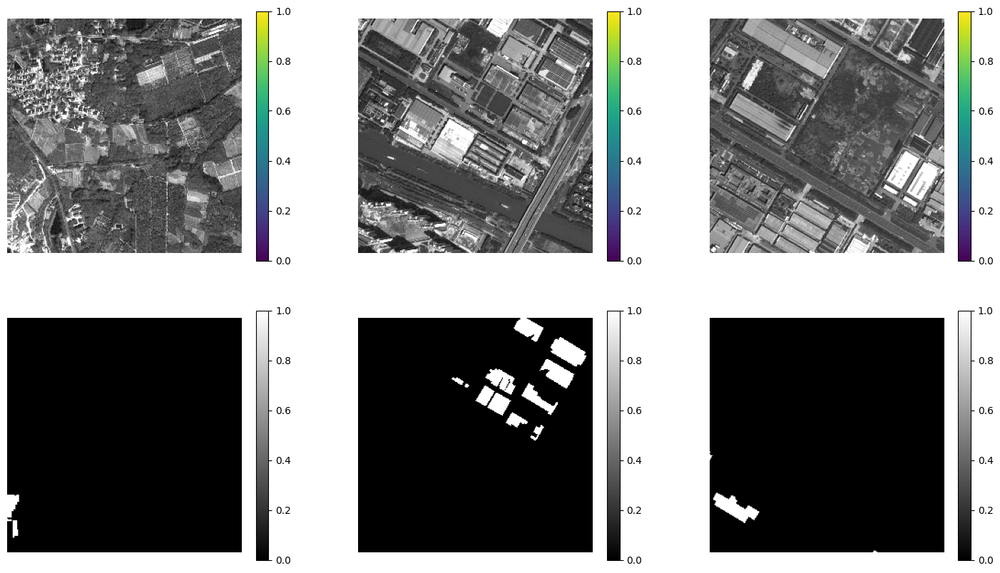

In [ ]:
# Snippet to see some examples of images along with their masks
NORM = mpl.colors.Normalize(vmin=0, vmax=1)

plt.figure(figsize=(18,10))
for i in range(1,4):
    plt.subplot(2,3,i)
    img = train_images[i]
    plt.imshow(img)
    plt.colorbar()
    plt.axis('off')

for i in range(4,7):
    plt.subplot(2,3,i)
    img = np.squeeze(train_masks[i-3])
    plt.imshow(img, cmap='gray', norm=NORM)
    plt.colorbar()
    plt.axis('off')
plt.show()

**Define the U-Net architecture with transfer learning (Using MobileNetV2 as the base model**

In [ ]:
# U-Net model, with MobileNetV2 as its base model. Down stack parameters will not be trained
def unet_model(output_channels):
    IMG_HEIGHT = X_train.shape[1]
    IMG_WIDTH  = X_train.shape[2]
    IMG_CHANNELS = X_train.shape[3]

    base_model = MobileNetV2(input_shape=[IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS], include_top=False)

    # Use the activations of these layers
    layer_names = [
        'block_1_expand_relu',   # 64x64
        'block_3_expand_relu',   # 32x32
        'block_6_expand_relu',   # 16x16
        'block_13_expand_relu',  # 8x8
        'block_16_project',      # 4x4
    ]

    base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

    # Create feature extraction model
    down_stack = Model(inputs=base_model.input, outputs=base_model_outputs)

    down_stack.trainable = False

    up_stack = [
        pix2pix.upsample(512, 3),  # 4x4   -> 8x8
        pix2pix.upsample(256, 3),  # 8x8   -> 16x16
        pix2pix.upsample(128, 3),  # 16x16 -> 32x32
        pix2pix.upsample(64, 3),   # 32x32 -> 64x64
    ]

    inputs = Input(shape=[IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

    # Upsampling and establishing skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = Concatenate()
        x = concat([x, skip])

    # Last layer of the model
    last = Conv2DTranspose(2, 3, strides=2, padding='same')  #64x64 -> 128x128

    x = last(x)

    return Model(inputs=inputs, outputs=x)

**Observe Model Summary**

In [ ]:
# Print model summary in case
# input_size = (256, 256, 3)
model = unet_model(OUTPUT_CHANNELS)
# print(model.summary())
"""
Total params: 6,502,786
Trainable params: 4,658,882
Non-trainable params: 1,843,904

"""

'\nTotal params: 6,502,786\nTrainable params: 4,658,882\nNon-trainable params: 1,843,904\n\n'

In [ ]:
# Auxiliary functions
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = pred_mask[..., tf.newaxis]
    return pred_mask[0]


def show_predictions(epoch, dataset=None, num=50):
  if dataset:

    for image, mask in dataset.take(num):
        pred_mask = model.predict(image)
        plt.figure(figsize=(15, 10))
        plt.subplot(231)
        plt.title('Testing Image')
        plt.imshow(image[0], cmap='gray')
        plt.subplot(232)
        plt.title('Ground Truth')
        plt.imshow(mask[0], cmap='gray')
        plt.subplot(233)
        plt.title('Prediction on test image')
        plt.imshow(create_mask(pred_mask), cmap='gray')

        plt.savefig(f"results/mask_{str(ii)}.png")

        plt.show()
  else:
      fig = plt.figure(figsize=(12, 12))
      fig.suptitle(f"\n Epoch: {str(epoch)}\n", fontsize=16)

      plt.subplot(331)
      plt.title('Testing Image')
      plt.imshow(train_images[num], cmap='gray')
      plt.subplot(332)
      plt.title('Ground Truth')
      plt.imshow(train_masks[num], cmap='gray')
      plt.subplot(333)
      plt.title('Prediction on test image')
      plt.imshow(create_mask(model.predict(train_images[num][tf.newaxis, ...]))[:,:,0], cmap='gray')

      plt.subplot(334)
      plt.imshow(train_images[num+16], cmap='gray')
      plt.subplot(335)
      plt.imshow(train_masks[num+16], cmap='gray')
      plt.subplot(336)
      plt.imshow(create_mask(model.predict(train_images[num+16][tf.newaxis, ...]))[:,:,0], cmap='gray')
      plt.subplot(337)
      plt.imshow(train_images[num+14], cmap='gray')
      plt.subplot(338)
      plt.imshow(train_masks[num+14], cmap='gray')
      plt.subplot(339)
      plt.imshow(create_mask(model.predict(train_images[num+14][tf.newaxis, ...]))[:,:,0], cmap='gray')

      plt.show()

In [ ]:
# Compile the model
model = unet_model(OUTPUT_CHANNELS)
model.compile(optimizer= Adam(learning_rate = 0.001),
              loss=SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

# IOU could be used instead, metrics=[tf.keras.metrics.MeanIoU(num_classes=2)]
# IOU even better reflects the status

Epoch 1/50
1/1 [==============================] - 0s 27ms/step


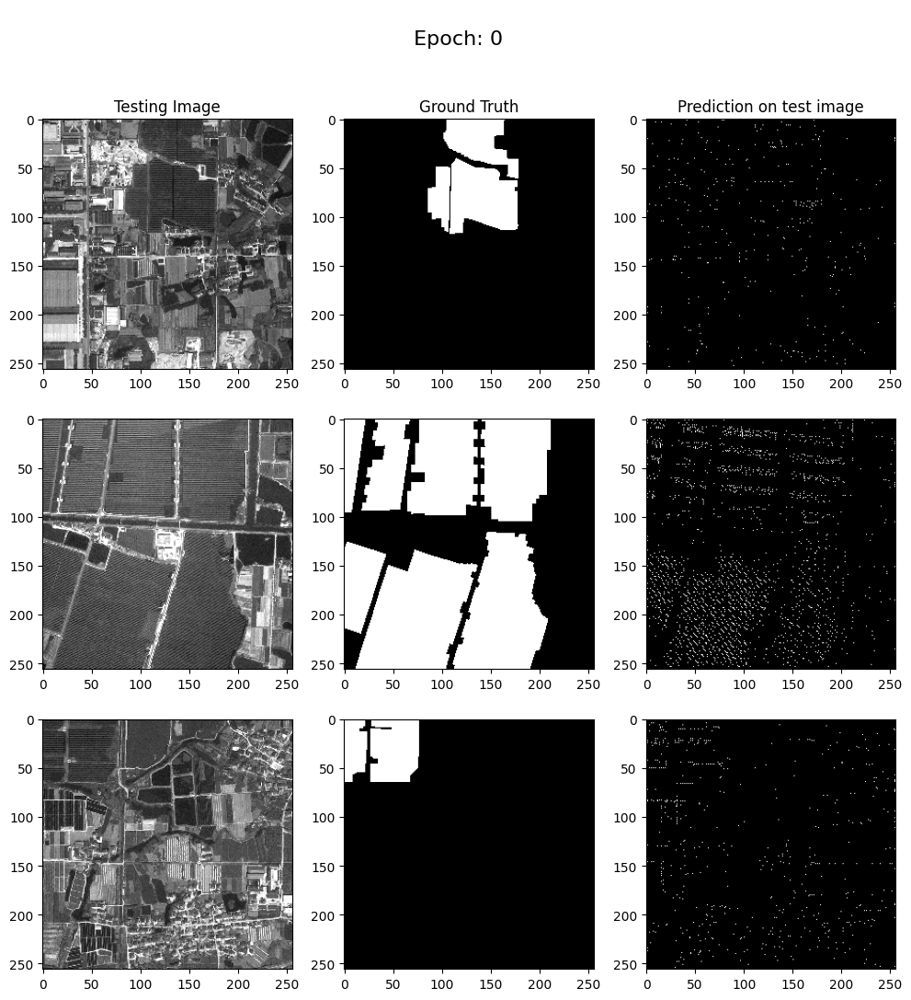


Sample Prediction after epoch 1

43/43 [==============================] - 19s 168ms/step - loss: 0.4934 - accuracy: 0.7742 - val_loss: 0.4030 - val_accuracy: 0.8564
Epoch 2/50
1/1 [==============================] - 0s 25ms/step


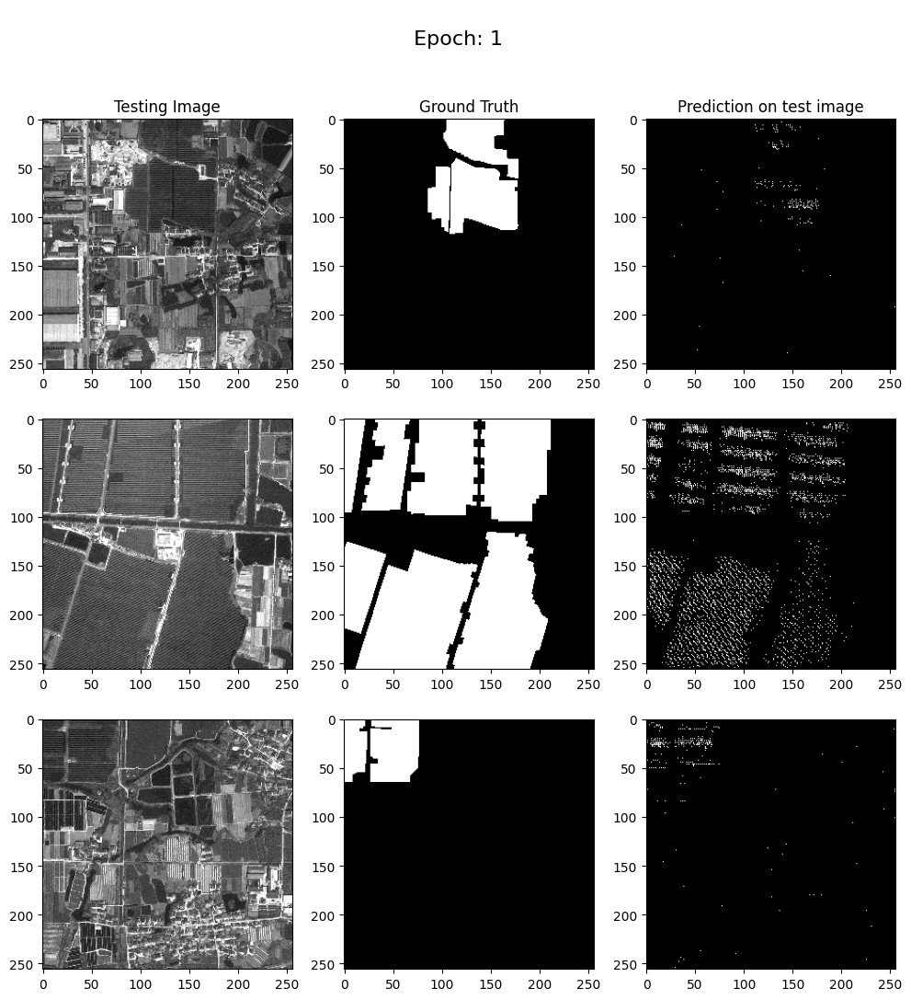


Sample Prediction after epoch 2

43/43 [==============================] - 3s 60ms/step - loss: 0.2637 - accuracy: 0.9054 - val_loss: 0.3424 - val_accuracy: 0.8632
Epoch 3/50
1/1 [==============================] - 0s 26ms/step


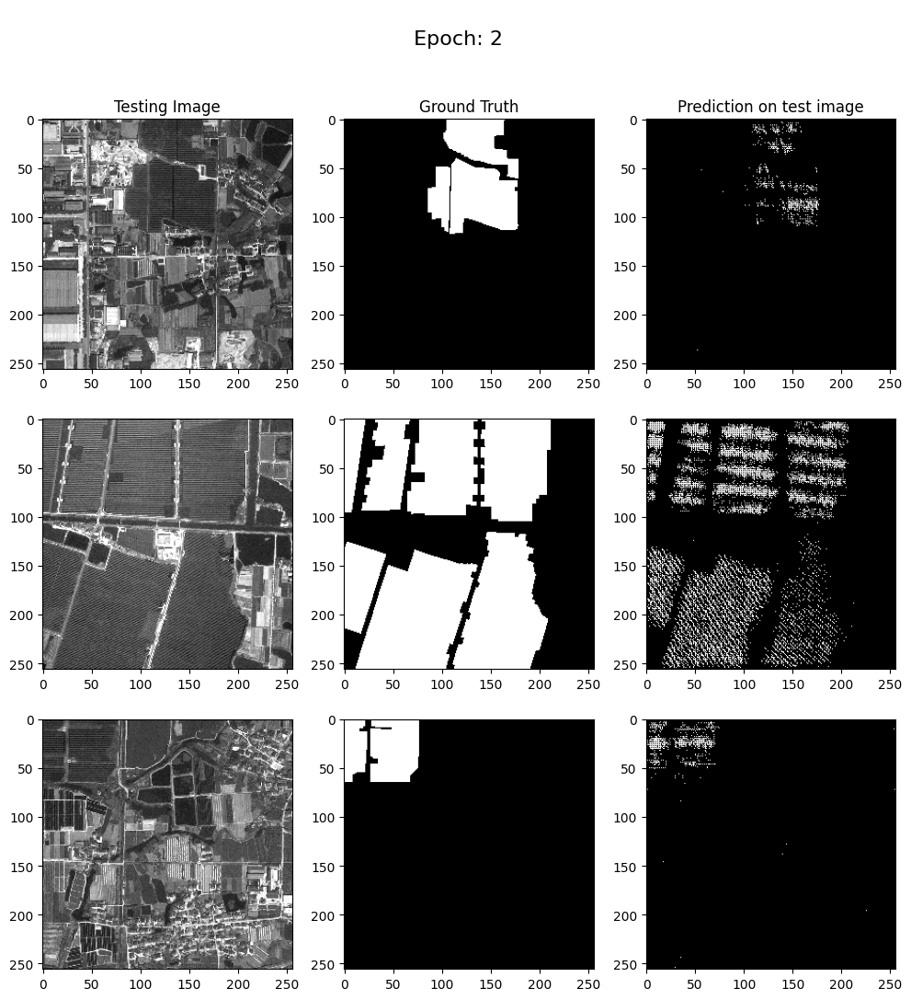


Sample Prediction after epoch 3

43/43 [==============================] - 3s 60ms/step - loss: 0.2082 - accuracy: 0.9236 - val_loss: 0.2970 - val_accuracy: 0.8735
Epoch 4/50
1/1 [==============================] - 0s 26ms/step


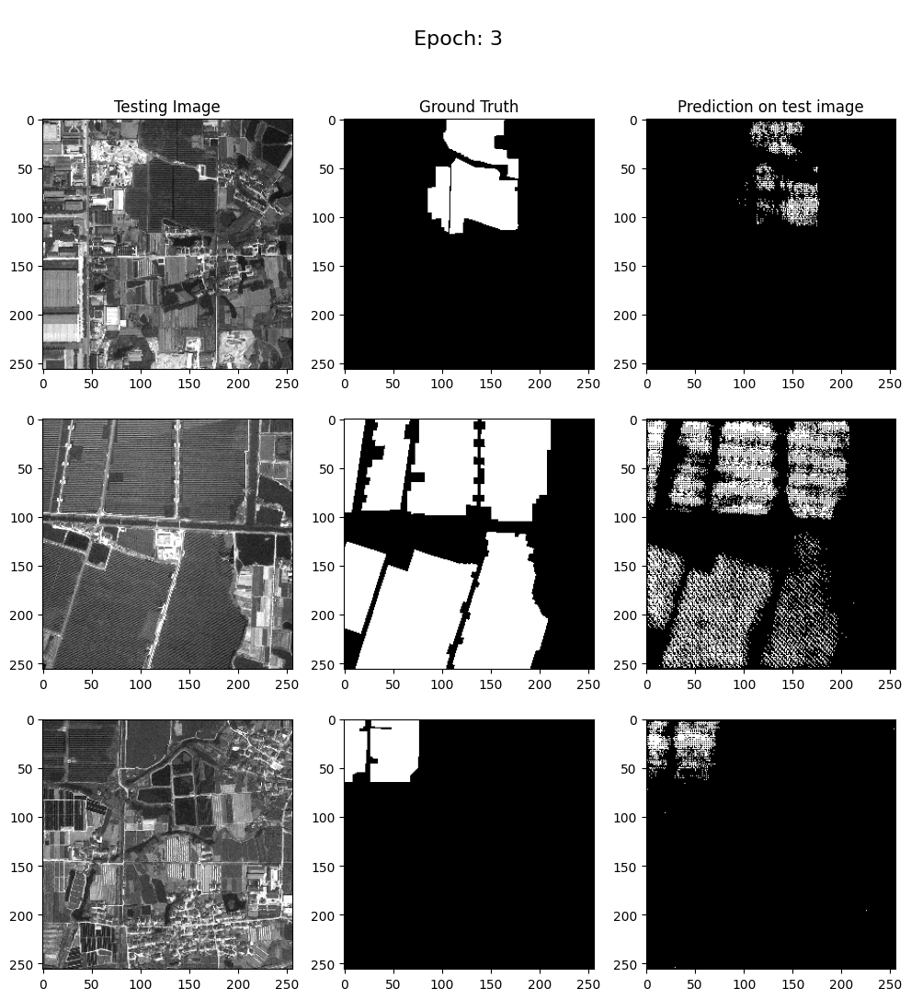


Sample Prediction after epoch 4

43/43 [==============================] - 3s 60ms/step - loss: 0.1786 - accuracy: 0.9367 - val_loss: 0.2571 - val_accuracy: 0.8886
Epoch 5/50
1/1 [==============================] - 0s 28ms/step


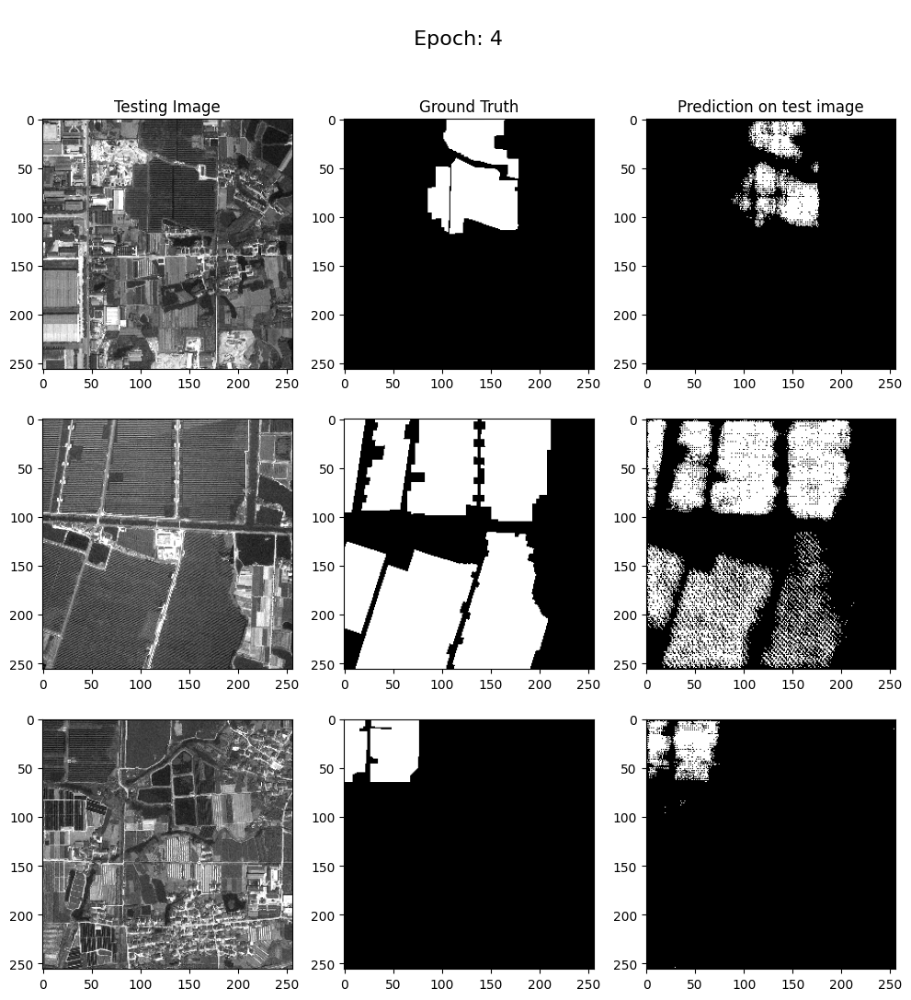


Sample Prediction after epoch 5

43/43 [==============================] - 3s 68ms/step - loss: 0.1601 - accuracy: 0.9444 - val_loss: 0.2145 - val_accuracy: 0.9102
Epoch 6/50
1/1 [==============================] - 0s 26ms/step


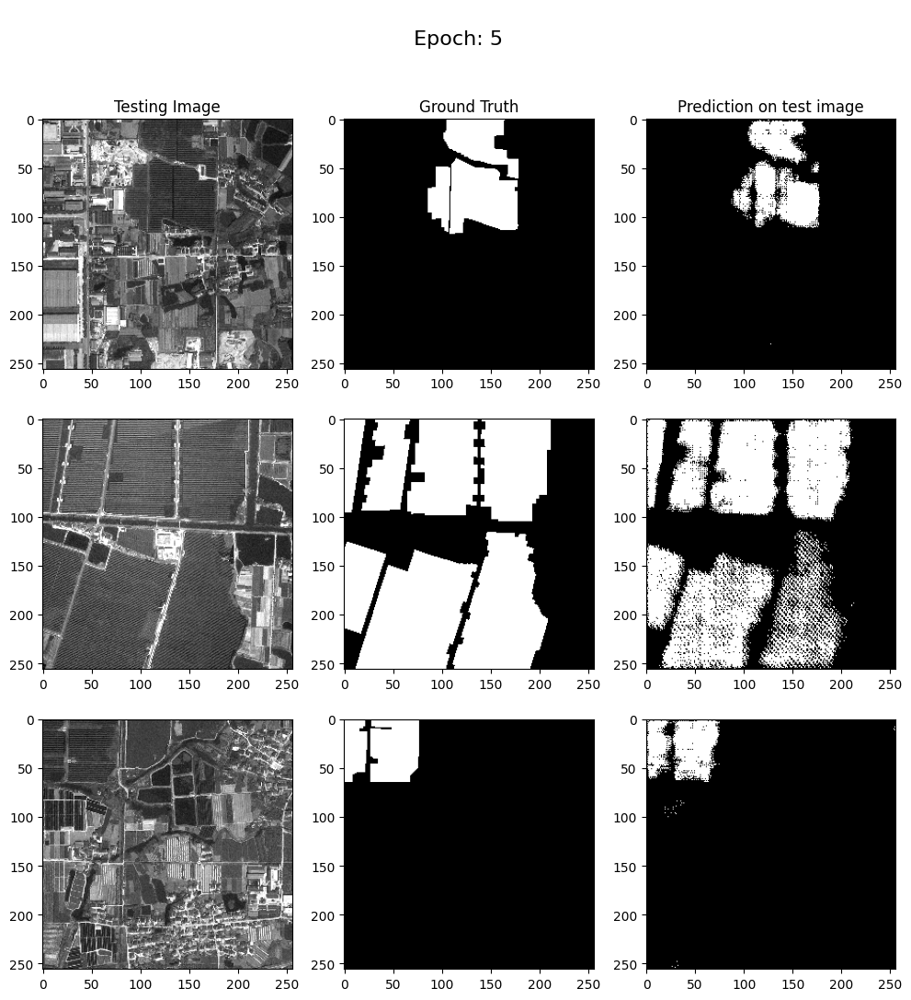


Sample Prediction after epoch 6

43/43 [==============================] - 3s 61ms/step - loss: 0.1474 - accuracy: 0.9495 - val_loss: 0.1853 - val_accuracy: 0.9266
Epoch 7/50
1/1 [==============================] - 0s 25ms/step


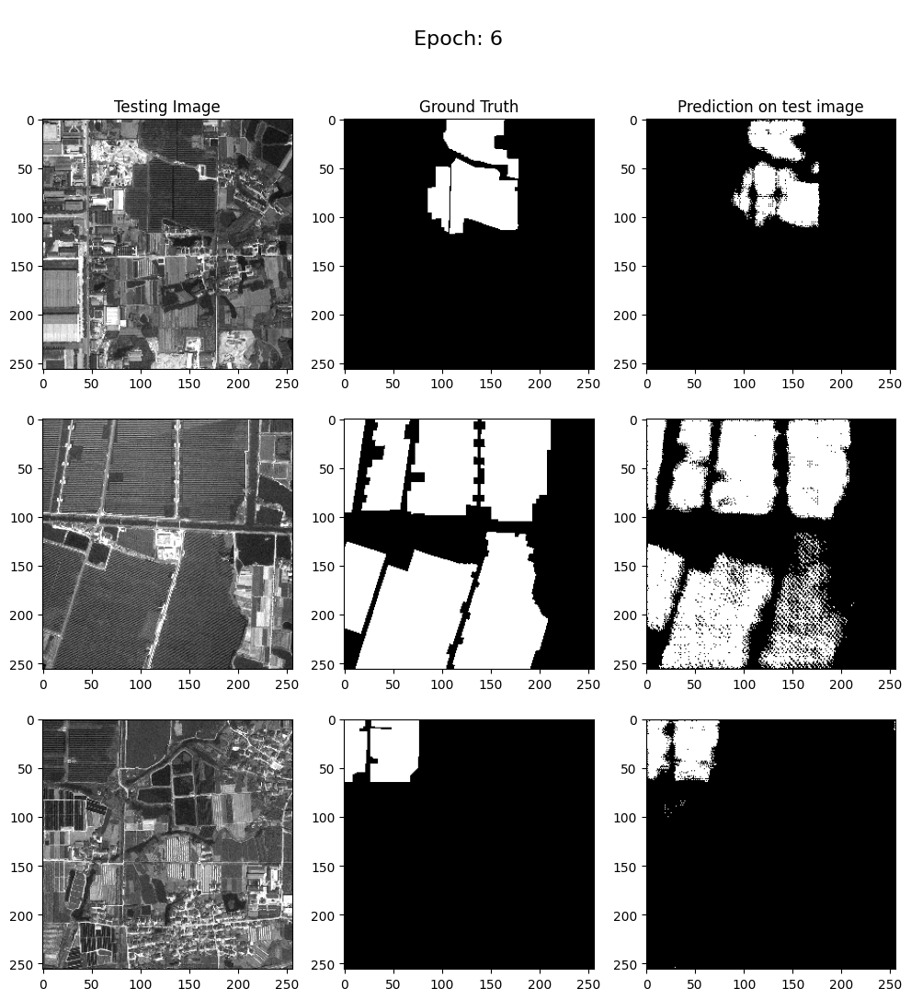


Sample Prediction after epoch 7

43/43 [==============================] - 3s 62ms/step - loss: 0.1341 - accuracy: 0.9543 - val_loss: 0.1813 - val_accuracy: 0.9290
Epoch 8/50
1/1 [==============================] - 0s 27ms/step


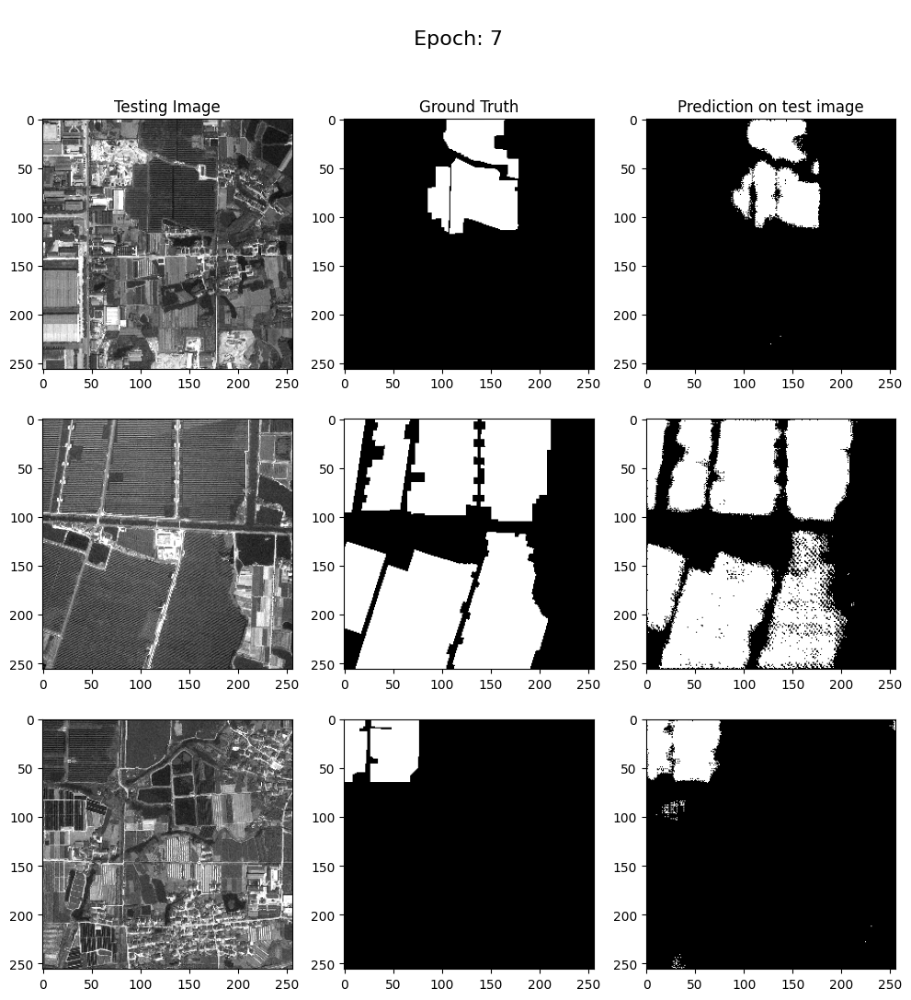


Sample Prediction after epoch 8

43/43 [==============================] - 3s 62ms/step - loss: 0.1277 - accuracy: 0.9559 - val_loss: 0.1524 - val_accuracy: 0.9444
Epoch 9/50
1/1 [==============================] - 0s 26ms/step


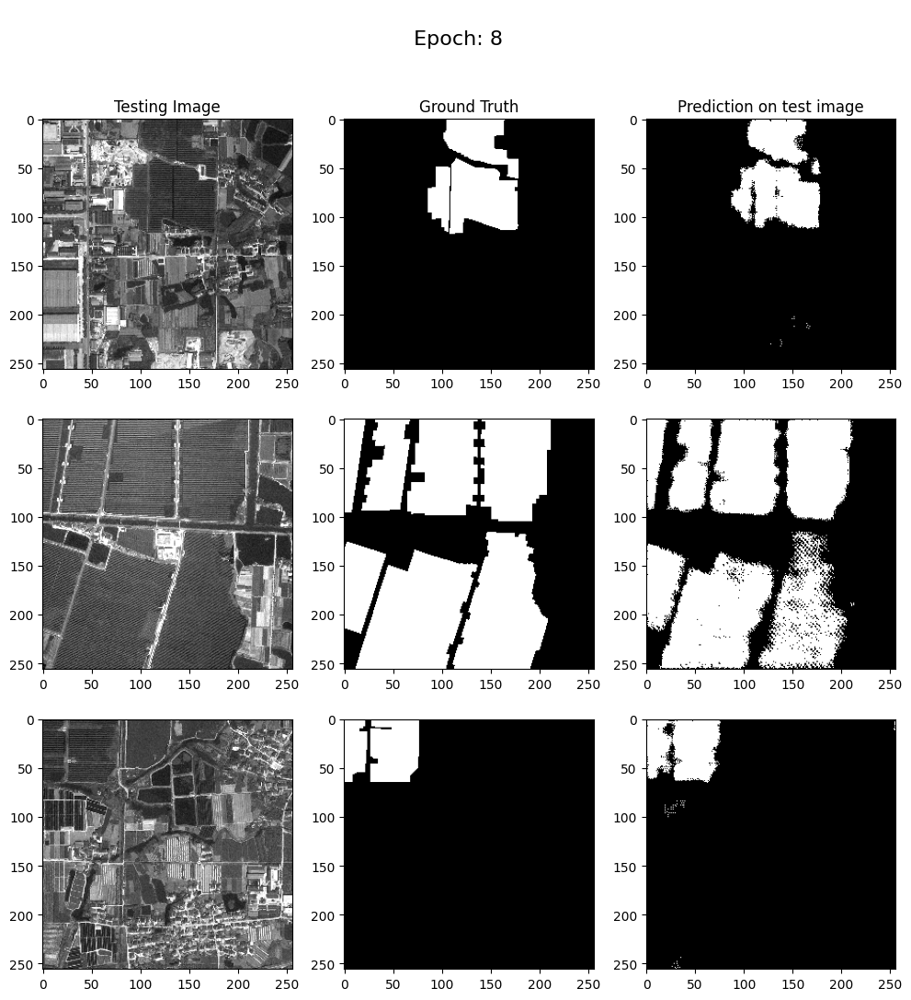


Sample Prediction after epoch 9

43/43 [==============================] - 3s 60ms/step - loss: 0.1213 - accuracy: 0.9579 - val_loss: 0.1443 - val_accuracy: 0.9487
Epoch 10/50
1/1 [==============================] - 0s 29ms/step


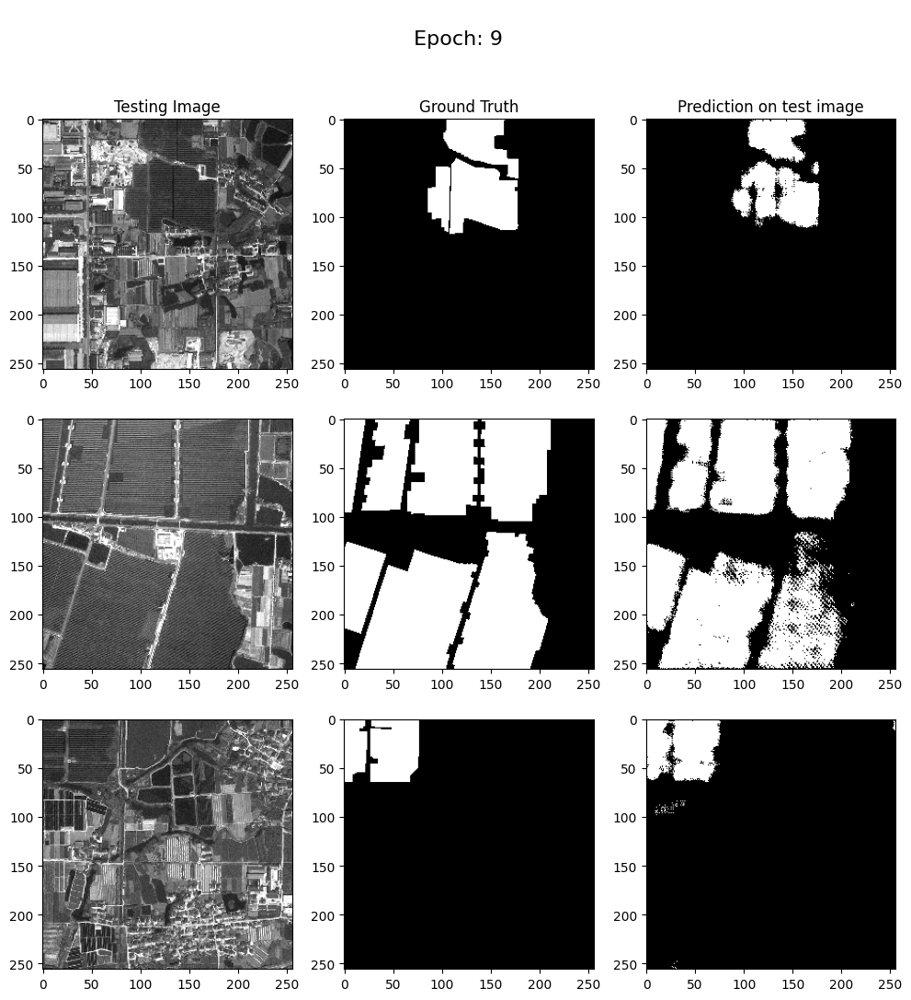


Sample Prediction after epoch 10

43/43 [==============================] - 3s 68ms/step - loss: 0.1147 - accuracy: 0.9601 - val_loss: 0.1452 - val_accuracy: 0.9472
Epoch 11/50
1/1 [==============================] - 0s 26ms/step


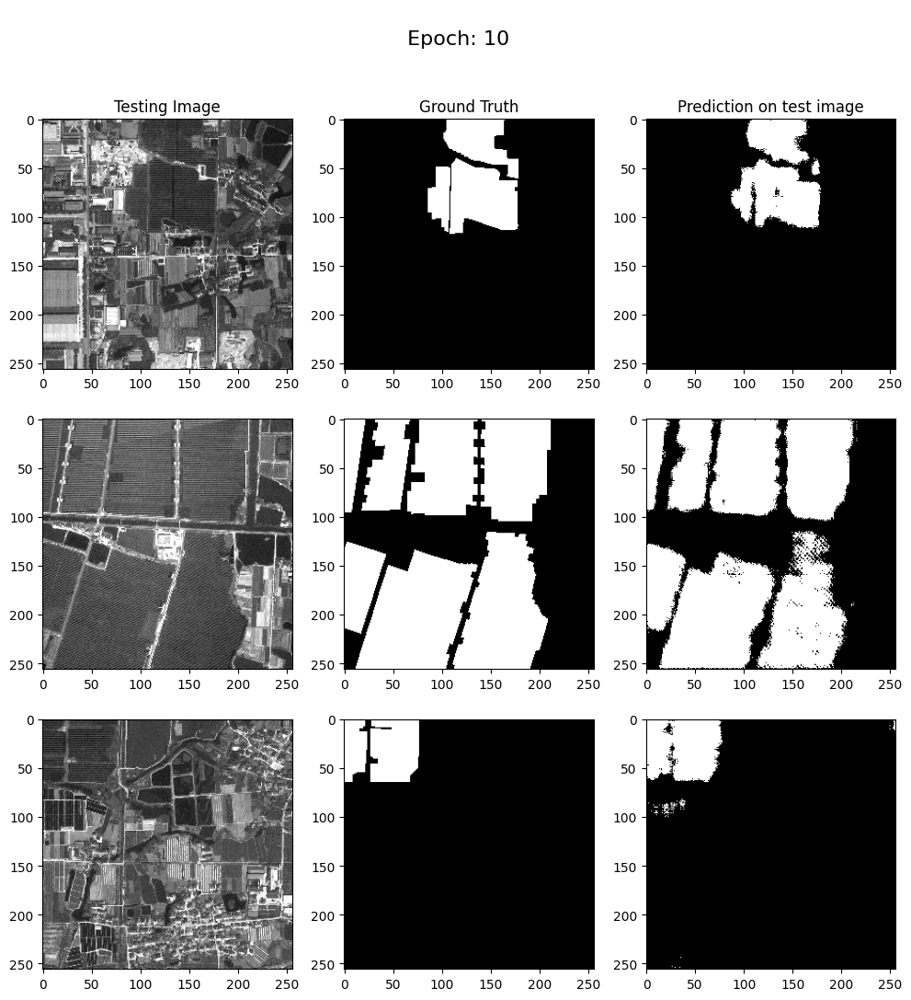


Sample Prediction after epoch 11

43/43 [==============================] - 3s 62ms/step - loss: 0.1104 - accuracy: 0.9612 - val_loss: 0.1357 - val_accuracy: 0.9513
Epoch 12/50
1/1 [==============================] - 0s 27ms/step


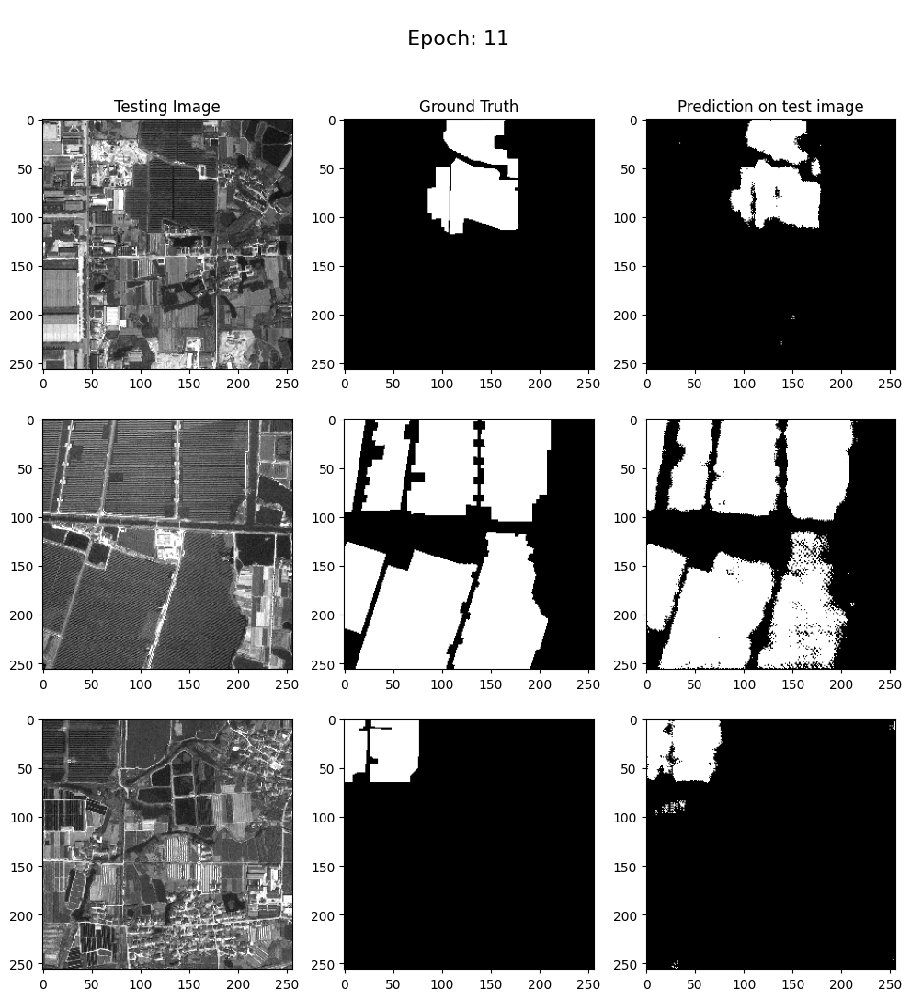


Sample Prediction after epoch 12

43/43 [==============================] - 3s 62ms/step - loss: 0.1056 - accuracy: 0.9629 - val_loss: 0.1357 - val_accuracy: 0.9509
Epoch 13/50
1/1 [==============================] - 0s 26ms/step


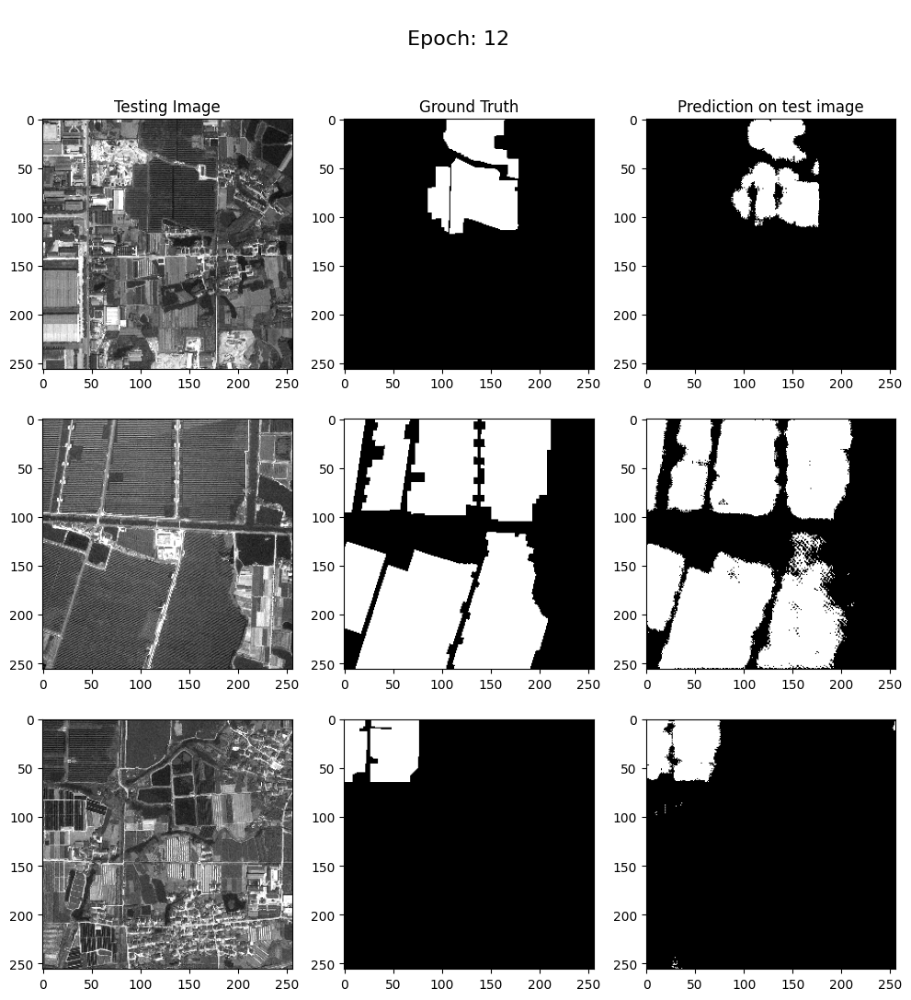


Sample Prediction after epoch 13

43/43 [==============================] - 3s 61ms/step - loss: 0.1033 - accuracy: 0.9633 - val_loss: 0.1587 - val_accuracy: 0.9416
Epoch 14/50
1/1 [==============================] - 0s 26ms/step


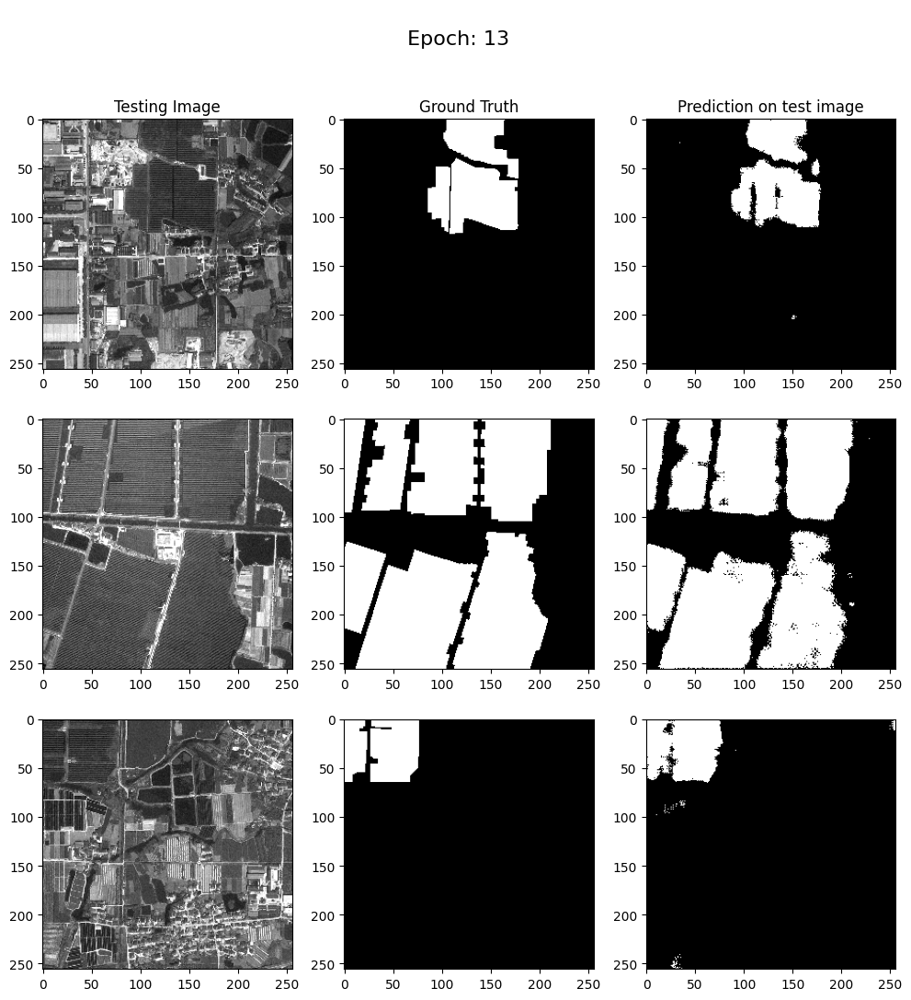


Sample Prediction after epoch 14

43/43 [==============================] - 3s 61ms/step - loss: 0.0962 - accuracy: 0.9655 - val_loss: 0.1344 - val_accuracy: 0.9503
Epoch 15/50
1/1 [==============================] - 0s 33ms/step


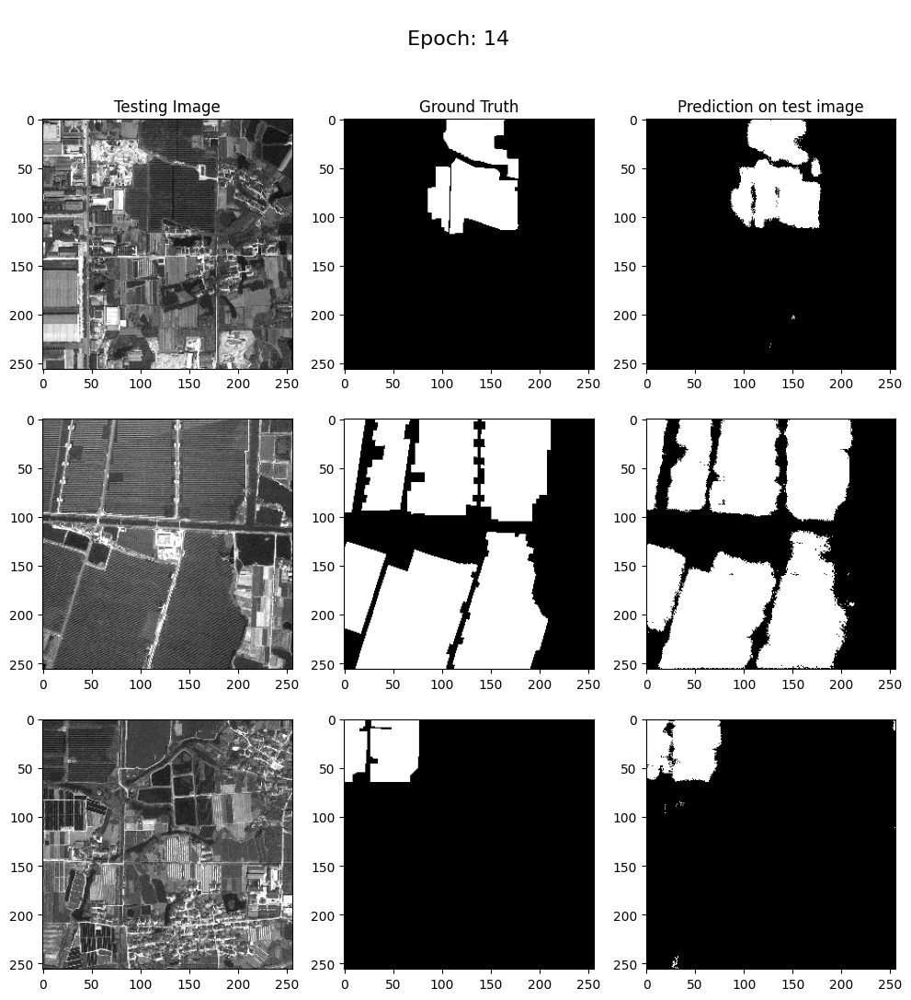


Sample Prediction after epoch 15

43/43 [==============================] - 3s 68ms/step - loss: 0.0933 - accuracy: 0.9666 - val_loss: 0.1322 - val_accuracy: 0.9519
Epoch 16/50
1/1 [==============================] - 0s 27ms/step


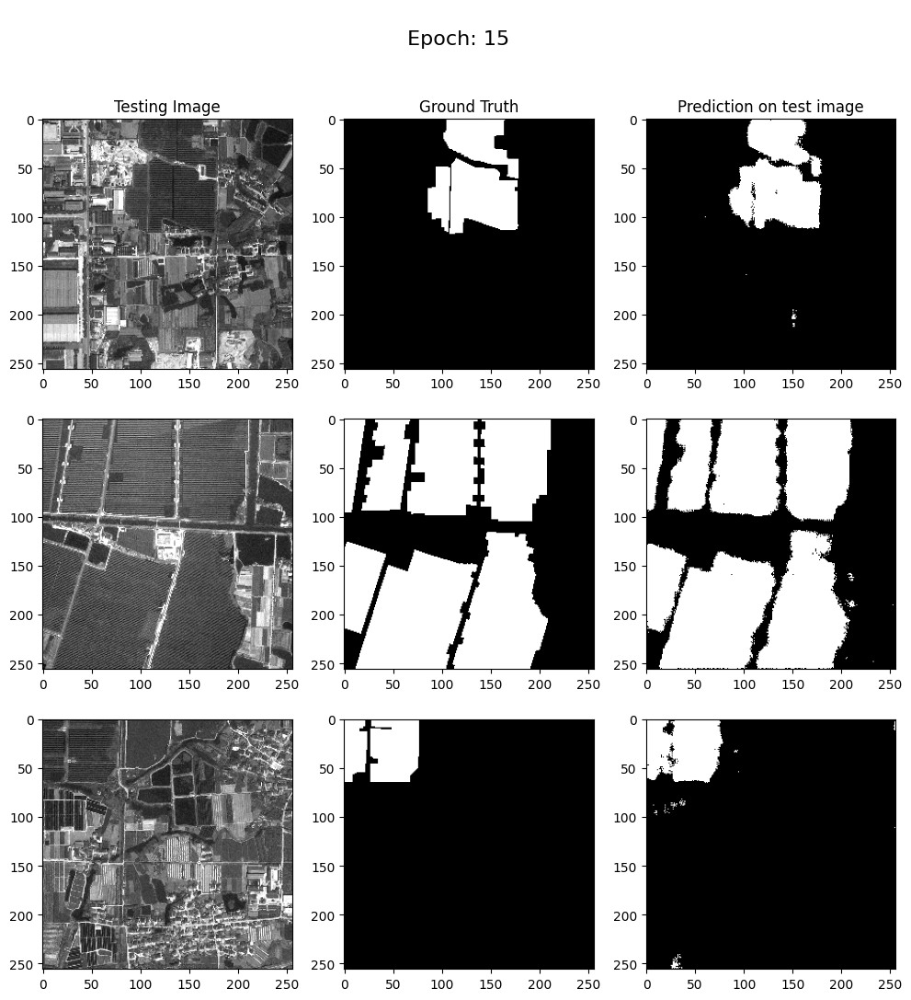


Sample Prediction after epoch 16

43/43 [==============================] - 3s 61ms/step - loss: 0.0870 - accuracy: 0.9688 - val_loss: 0.1248 - val_accuracy: 0.9554
Epoch 17/50
1/1 [==============================] - 0s 25ms/step


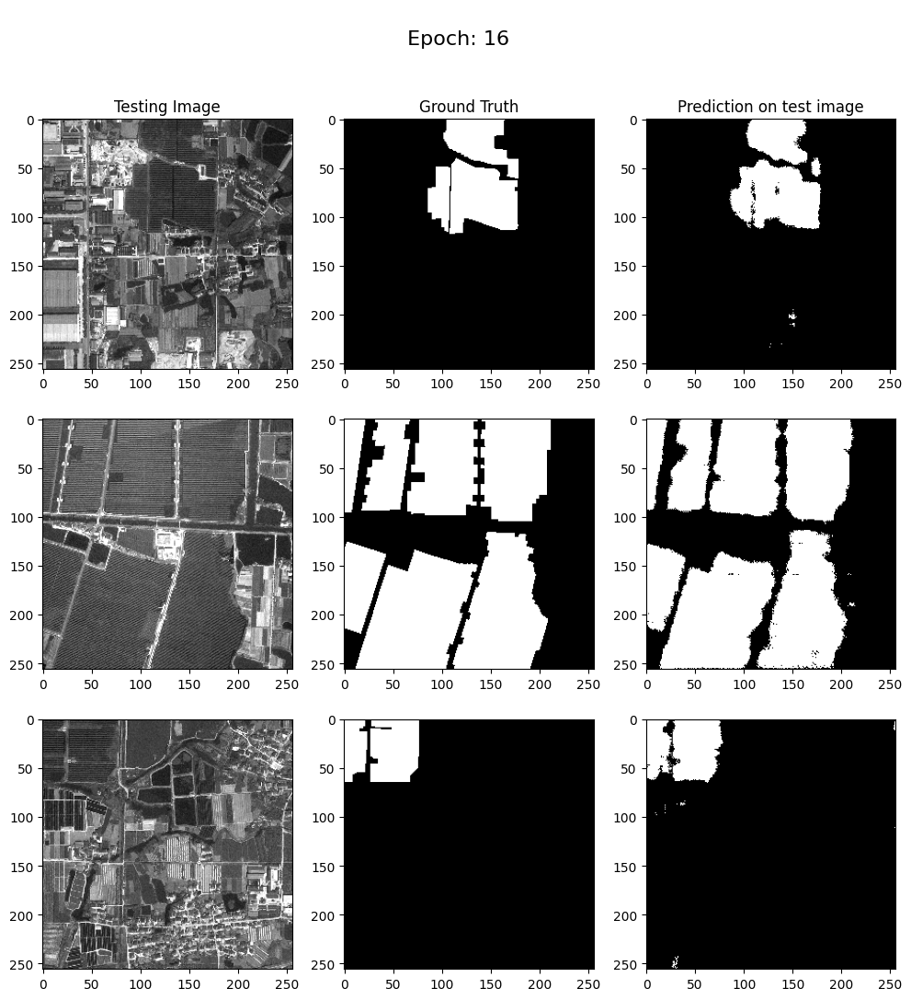


Sample Prediction after epoch 17

43/43 [==============================] - 3s 61ms/step - loss: 0.0842 - accuracy: 0.9700 - val_loss: 0.1326 - val_accuracy: 0.9514
Epoch 18/50
1/1 [==============================] - 0s 25ms/step


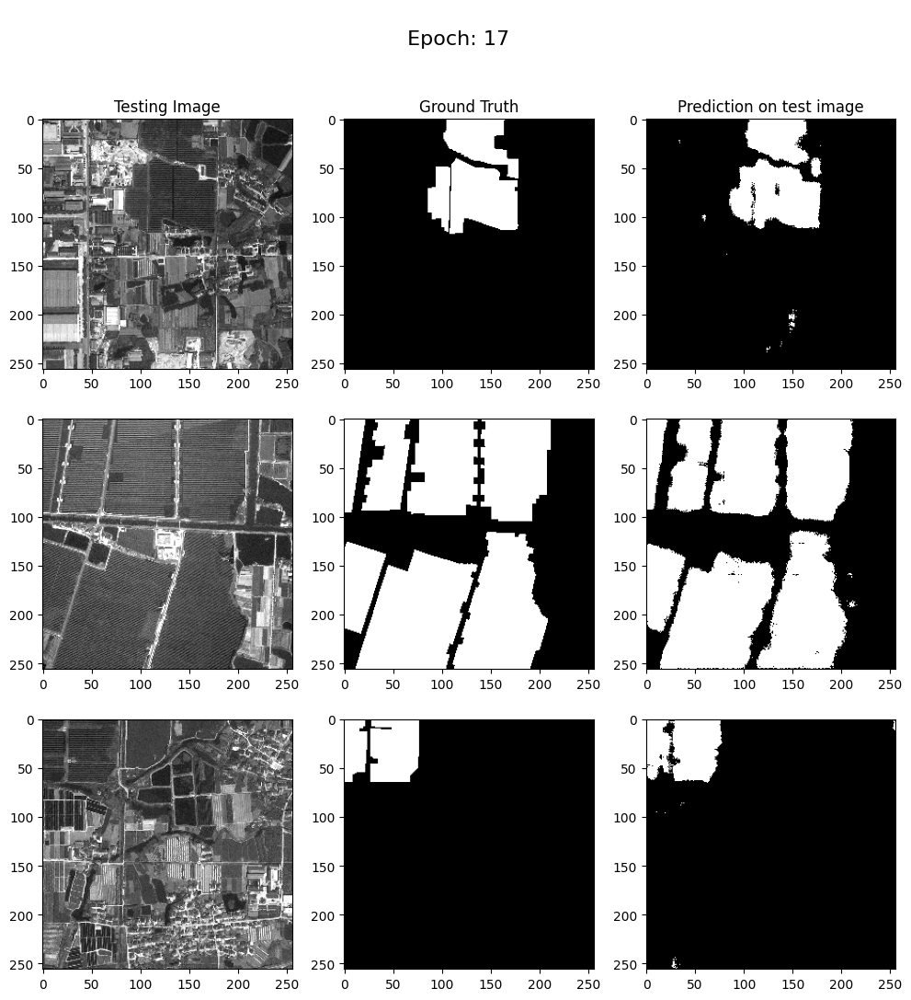


Sample Prediction after epoch 18

43/43 [==============================] - 3s 61ms/step - loss: 0.0777 - accuracy: 0.9723 - val_loss: 0.1337 - val_accuracy: 0.9514
Epoch 19/50
1/1 [==============================] - 0s 28ms/step


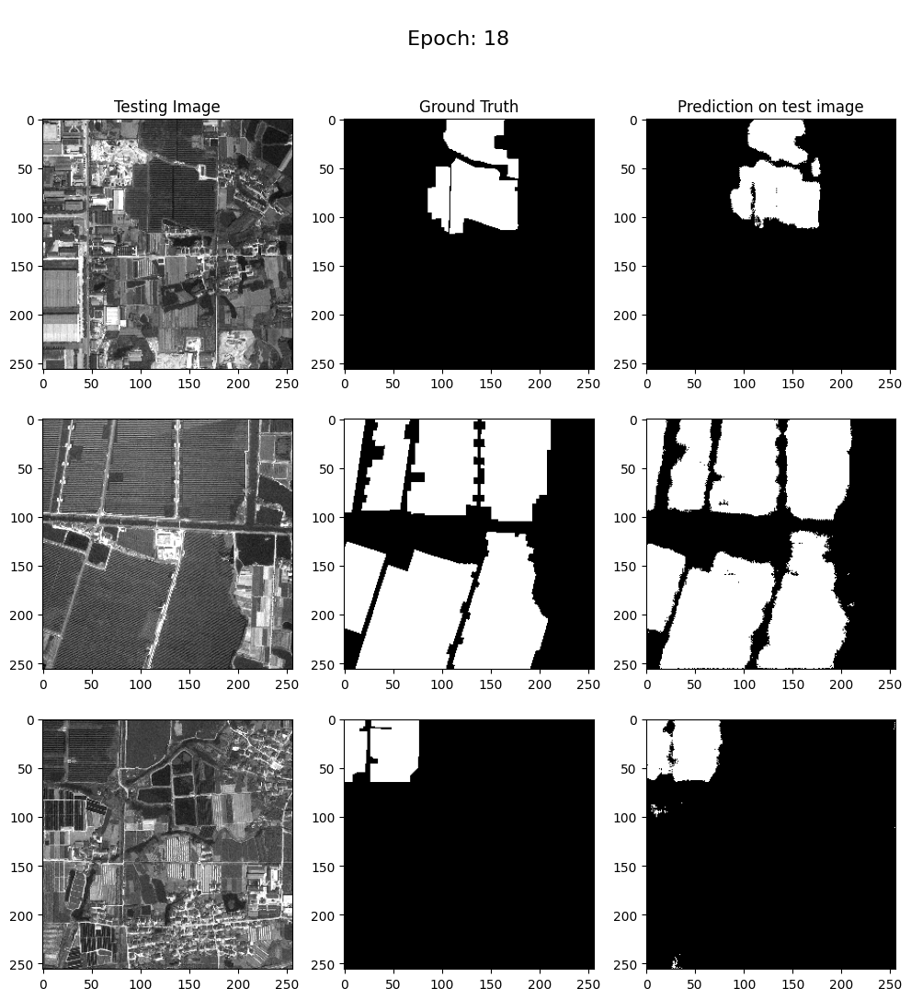


Sample Prediction after epoch 19

43/43 [==============================] - 3s 60ms/step - loss: 0.0726 - accuracy: 0.9740 - val_loss: 0.1322 - val_accuracy: 0.9523
Epoch 20/50
1/1 [==============================] - 0s 28ms/step


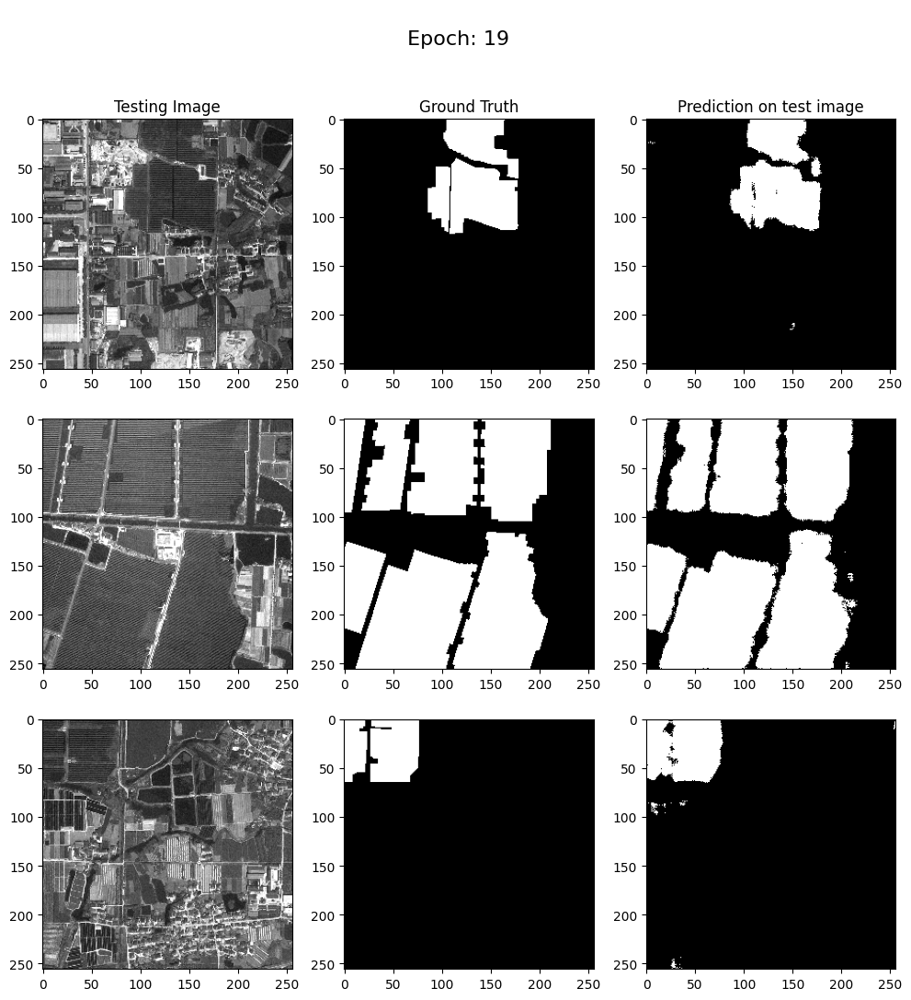


Sample Prediction after epoch 20

43/43 [==============================] - 3s 69ms/step - loss: 0.0711 - accuracy: 0.9745 - val_loss: 0.1309 - val_accuracy: 0.9540
Epoch 21/50
1/1 [==============================] - 0s 26ms/step


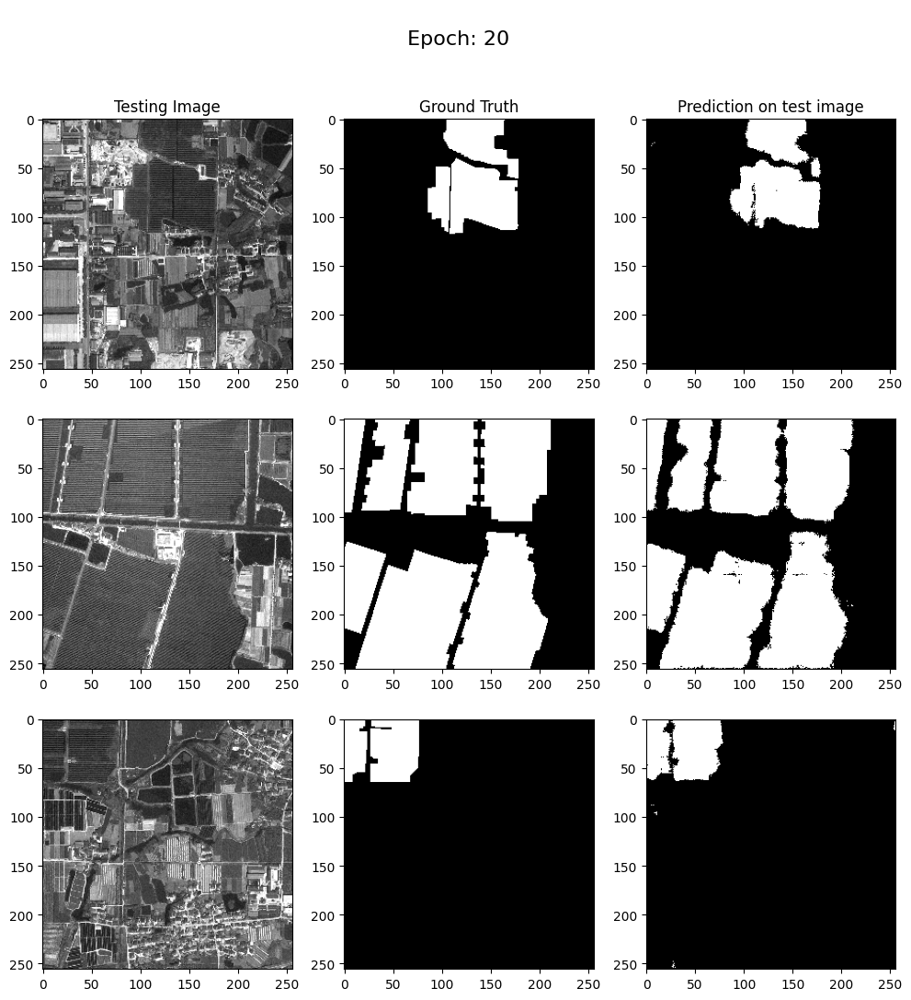


Sample Prediction after epoch 21

43/43 [==============================] - 3s 61ms/step - loss: 0.0697 - accuracy: 0.9751 - val_loss: 0.1508 - val_accuracy: 0.9464
Epoch 22/50
1/1 [==============================] - 0s 28ms/step


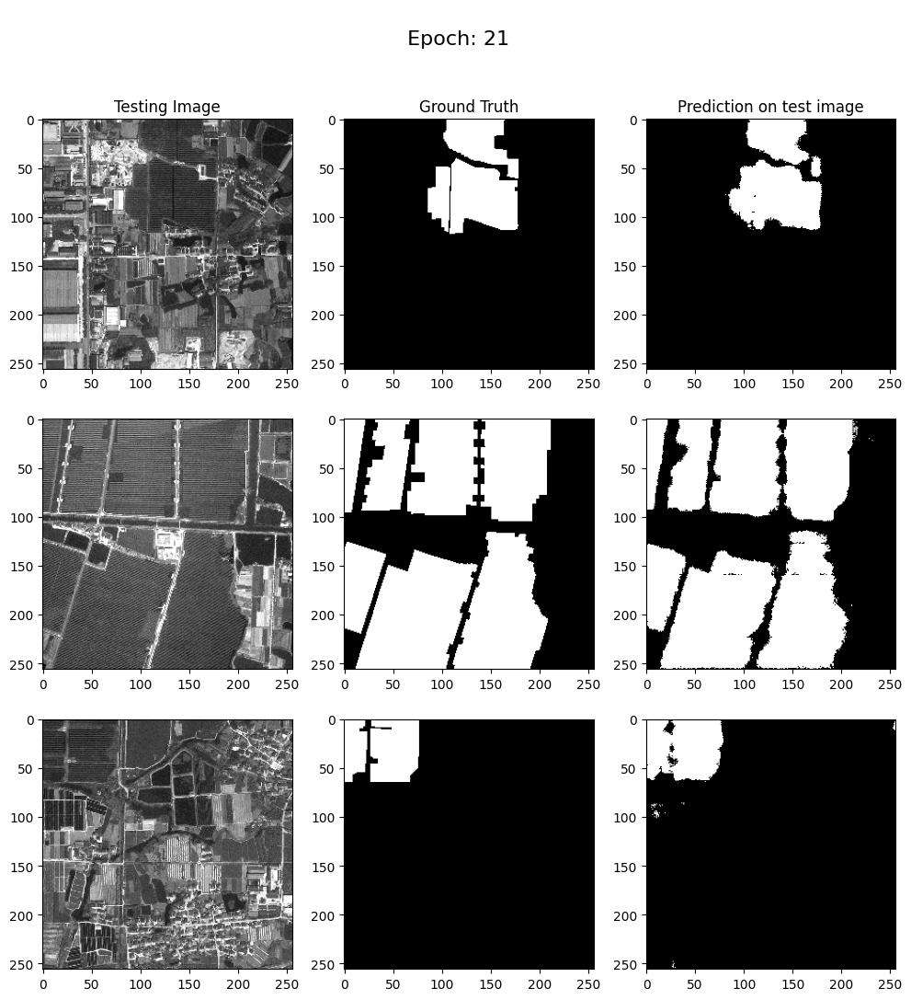


Sample Prediction after epoch 22

43/43 [==============================] - 3s 61ms/step - loss: 0.0690 - accuracy: 0.9751 - val_loss: 0.1316 - val_accuracy: 0.9543
Epoch 23/50
1/1 [==============================] - 0s 25ms/step


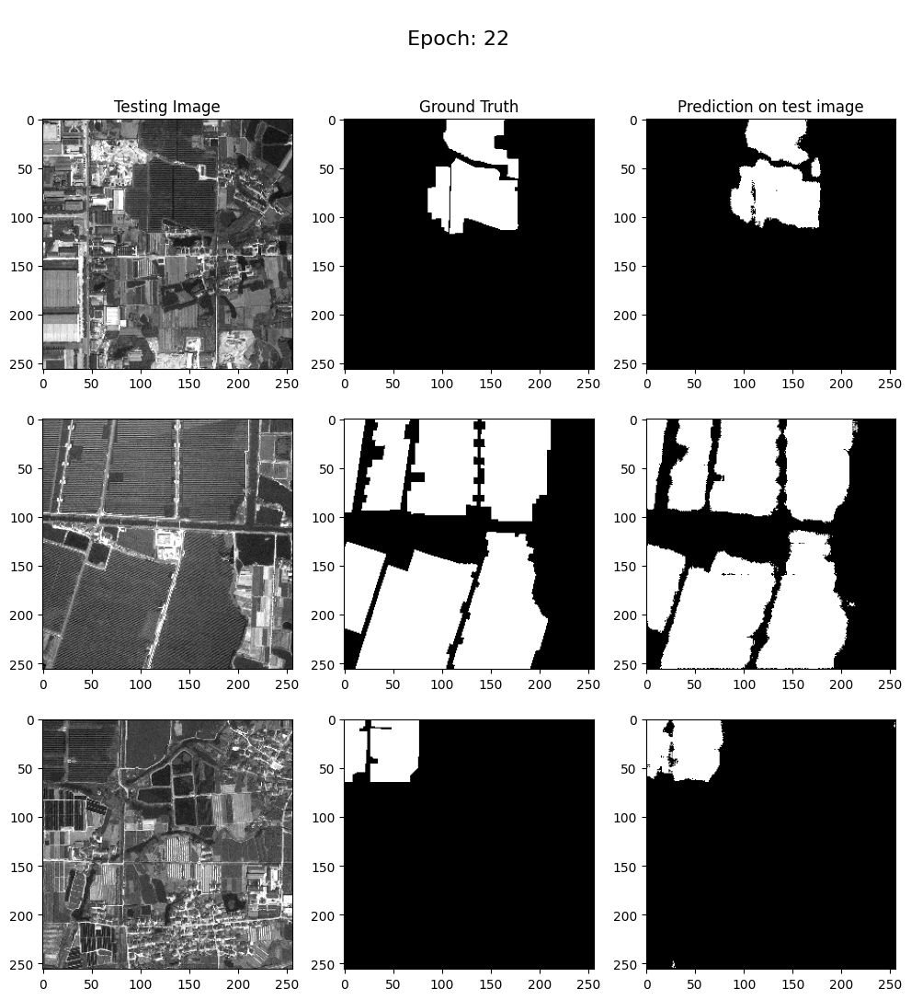


Sample Prediction after epoch 23

43/43 [==============================] - 3s 60ms/step - loss: 0.0657 - accuracy: 0.9762 - val_loss: 0.1345 - val_accuracy: 0.9537
Epoch 24/50
1/1 [==============================] - 0s 25ms/step


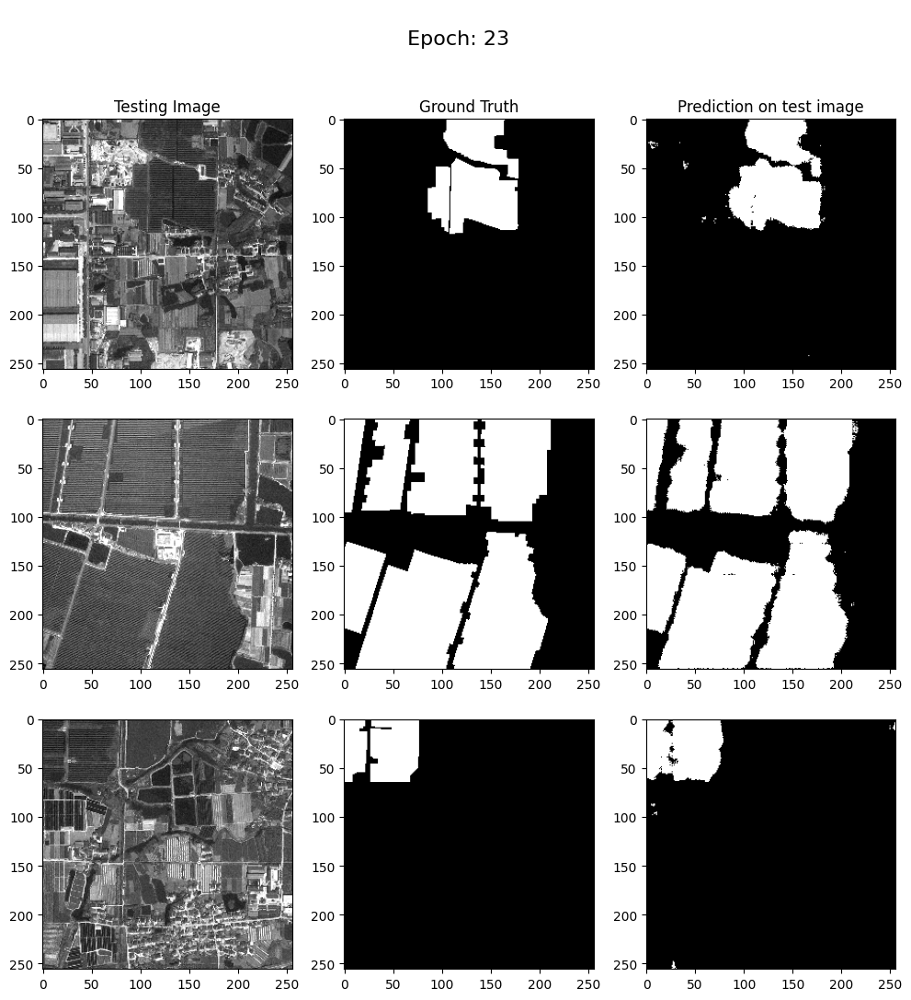


Sample Prediction after epoch 24

43/43 [==============================] - 3s 68ms/step - loss: 0.0623 - accuracy: 0.9777 - val_loss: 0.1314 - val_accuracy: 0.9543
Epoch 25/50
1/1 [==============================] - 0s 26ms/step


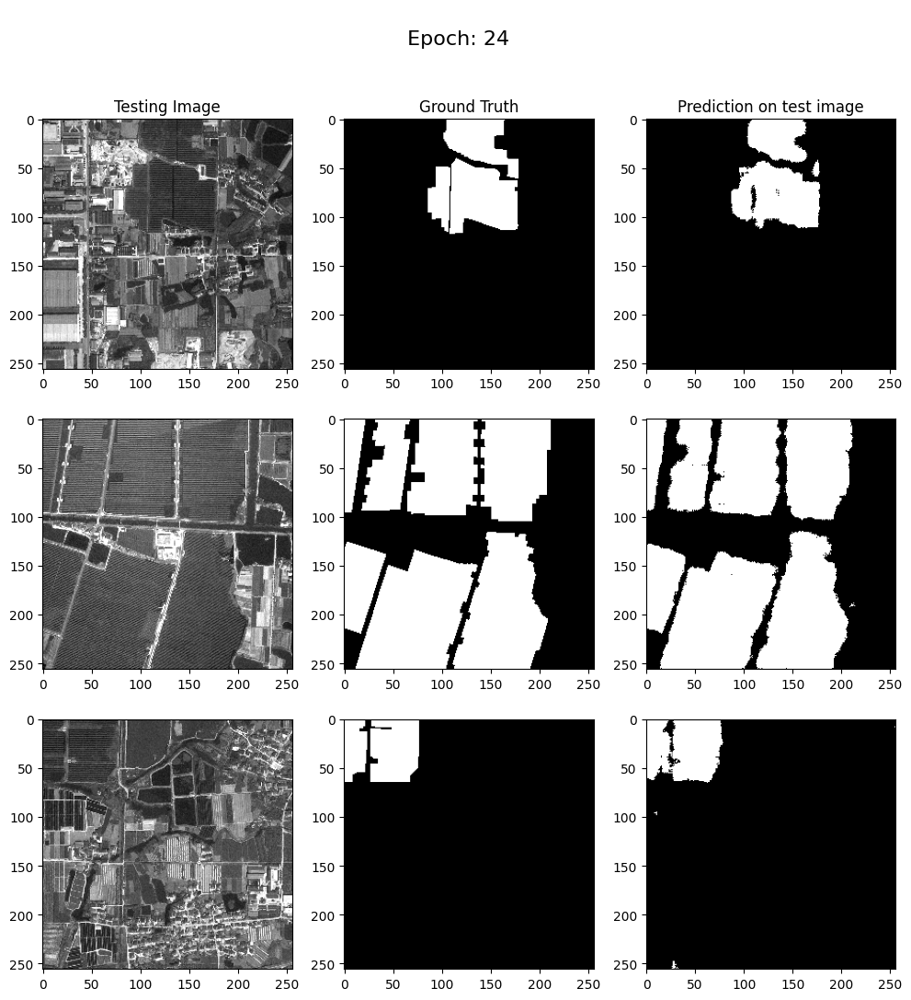


Sample Prediction after epoch 25

43/43 [==============================] - 3s 62ms/step - loss: 0.0586 - accuracy: 0.9788 - val_loss: 0.1563 - val_accuracy: 0.9486
Epoch 26/50
1/1 [==============================] - 0s 27ms/step


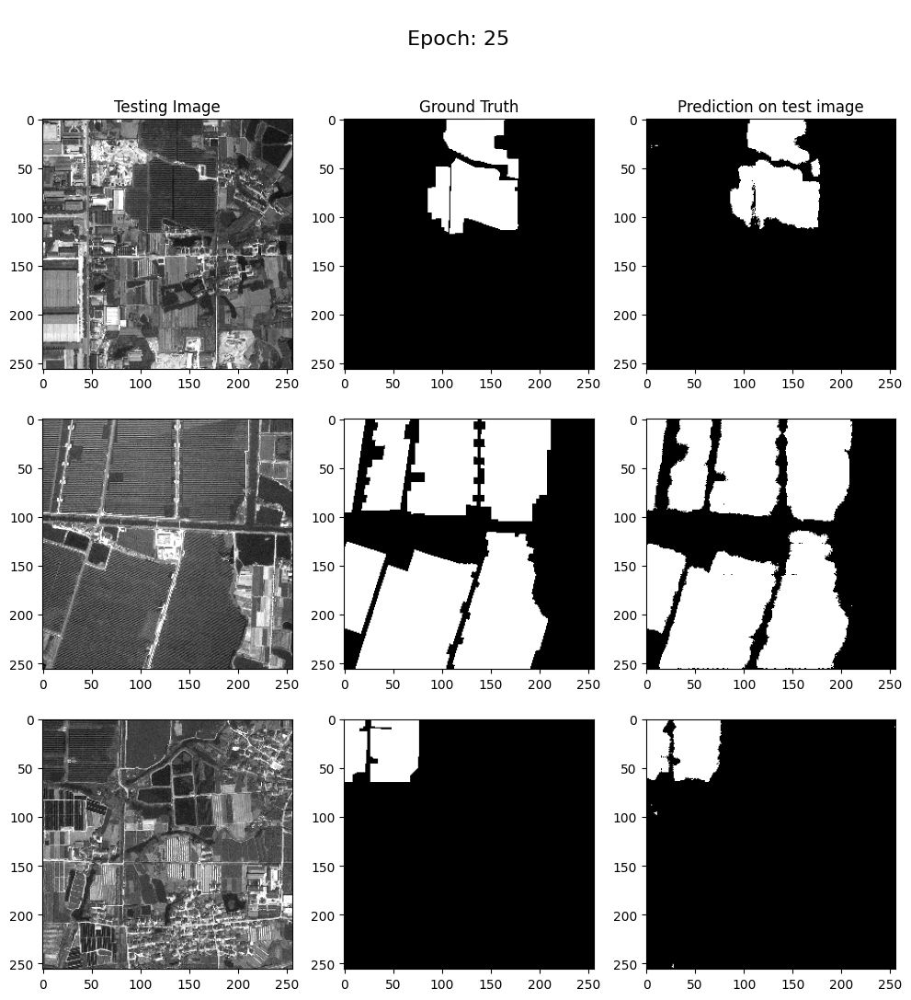


Sample Prediction after epoch 26

43/43 [==============================] - 3s 60ms/step - loss: 0.0550 - accuracy: 0.9804 - val_loss: 0.1454 - val_accuracy: 0.9500
Epoch 27/50
1/1 [==============================] - 0s 28ms/step


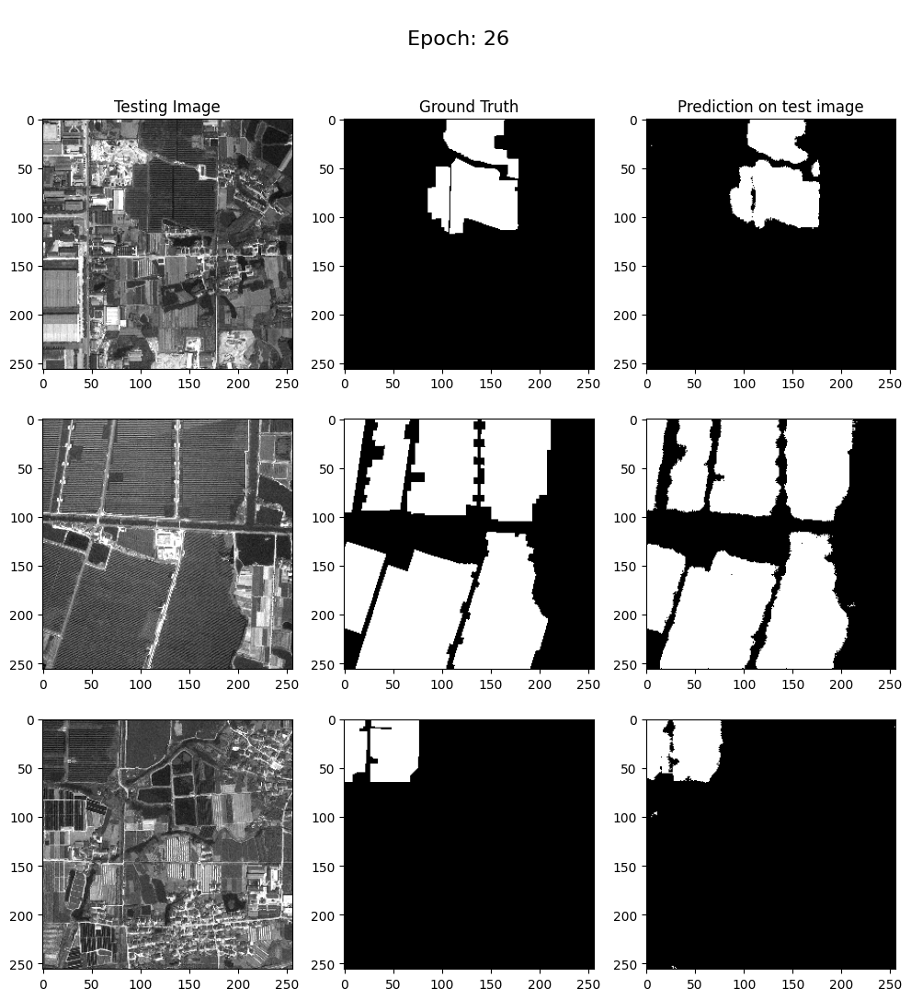


Sample Prediction after epoch 27

43/43 [==============================] - 3s 60ms/step - loss: 0.0522 - accuracy: 0.9812 - val_loss: 0.1533 - val_accuracy: 0.9502
Epoch 28/50
1/1 [==============================] - 0s 27ms/step


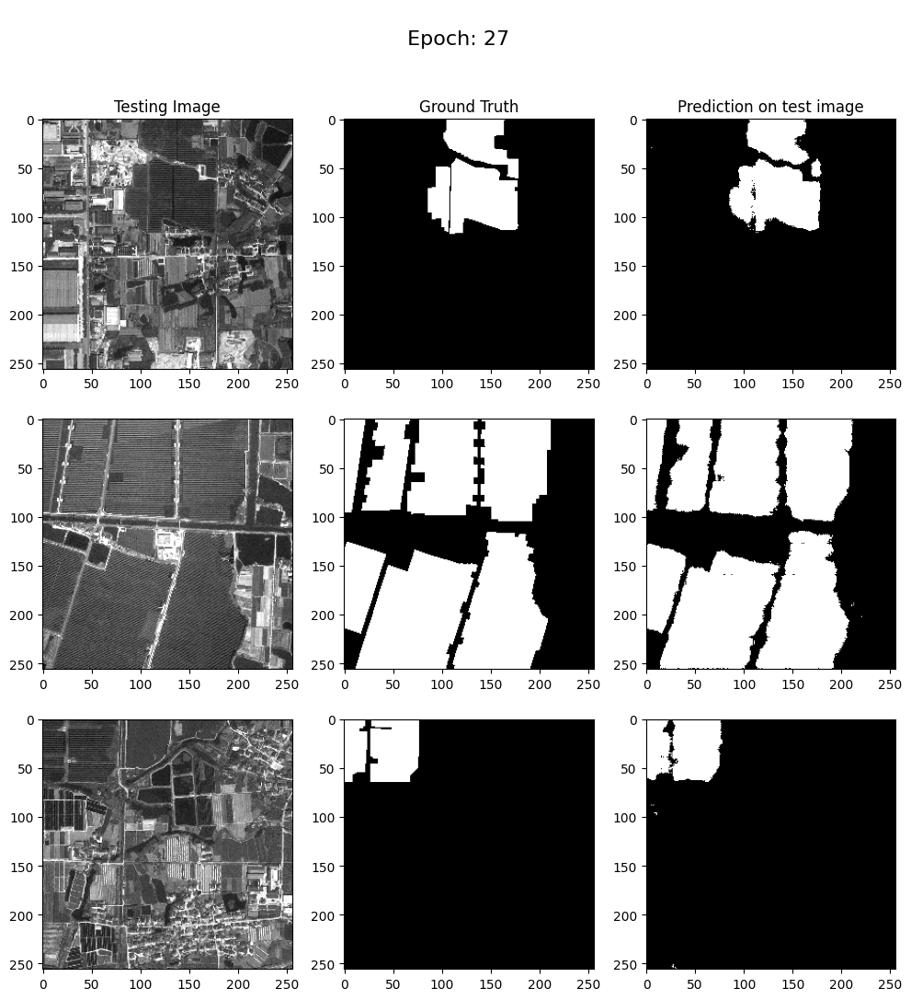


Sample Prediction after epoch 28

43/43 [==============================] - 3s 60ms/step - loss: 0.0500 - accuracy: 0.9819 - val_loss: 0.1359 - val_accuracy: 0.9537
Epoch 29/50
1/1 [==============================] - 0s 26ms/step


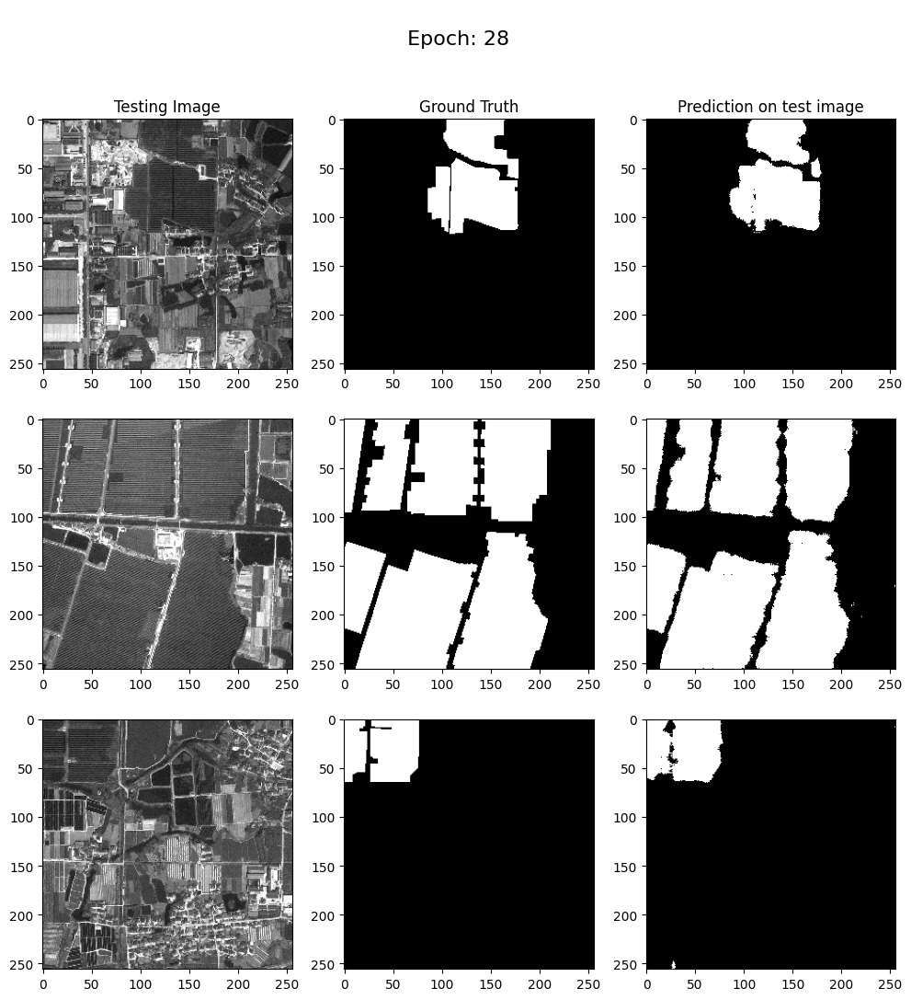


Sample Prediction after epoch 29

43/43 [==============================] - 3s 69ms/step - loss: 0.0506 - accuracy: 0.9817 - val_loss: 0.1322 - val_accuracy: 0.9555
Epoch 30/50
1/1 [==============================] - 0s 26ms/step


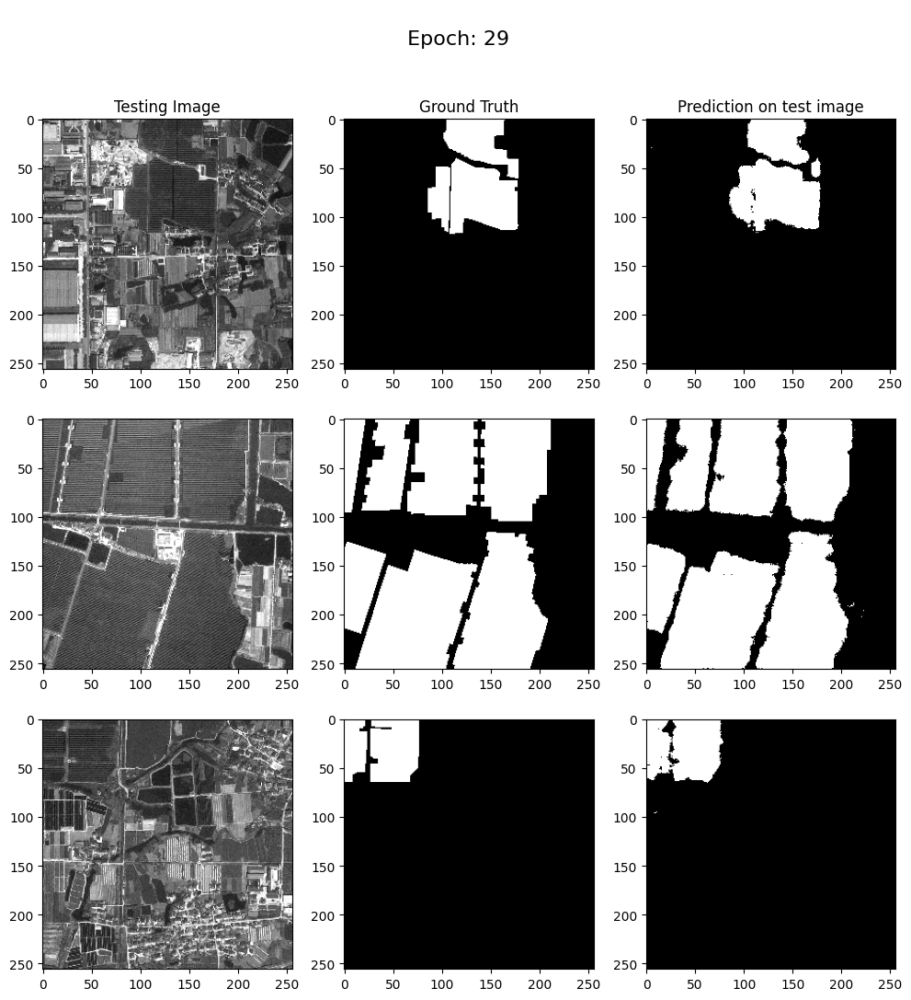


Sample Prediction after epoch 30

43/43 [==============================] - 3s 61ms/step - loss: 0.0479 - accuracy: 0.9826 - val_loss: 0.1421 - val_accuracy: 0.9536
Epoch 31/50
1/1 [==============================] - 0s 27ms/step


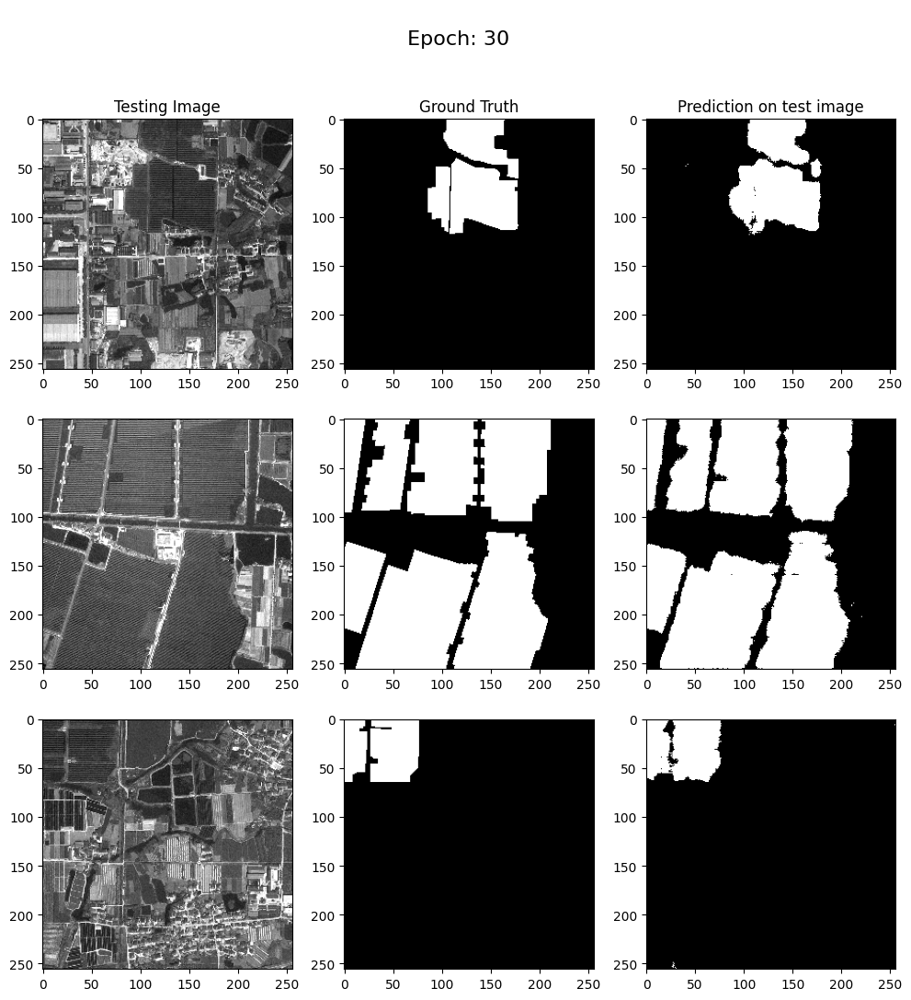


Sample Prediction after epoch 31

43/43 [==============================] - 3s 60ms/step - loss: 0.0470 - accuracy: 0.9830 - val_loss: 0.1490 - val_accuracy: 0.9516
Epoch 32/50
1/1 [==============================] - 0s 26ms/step


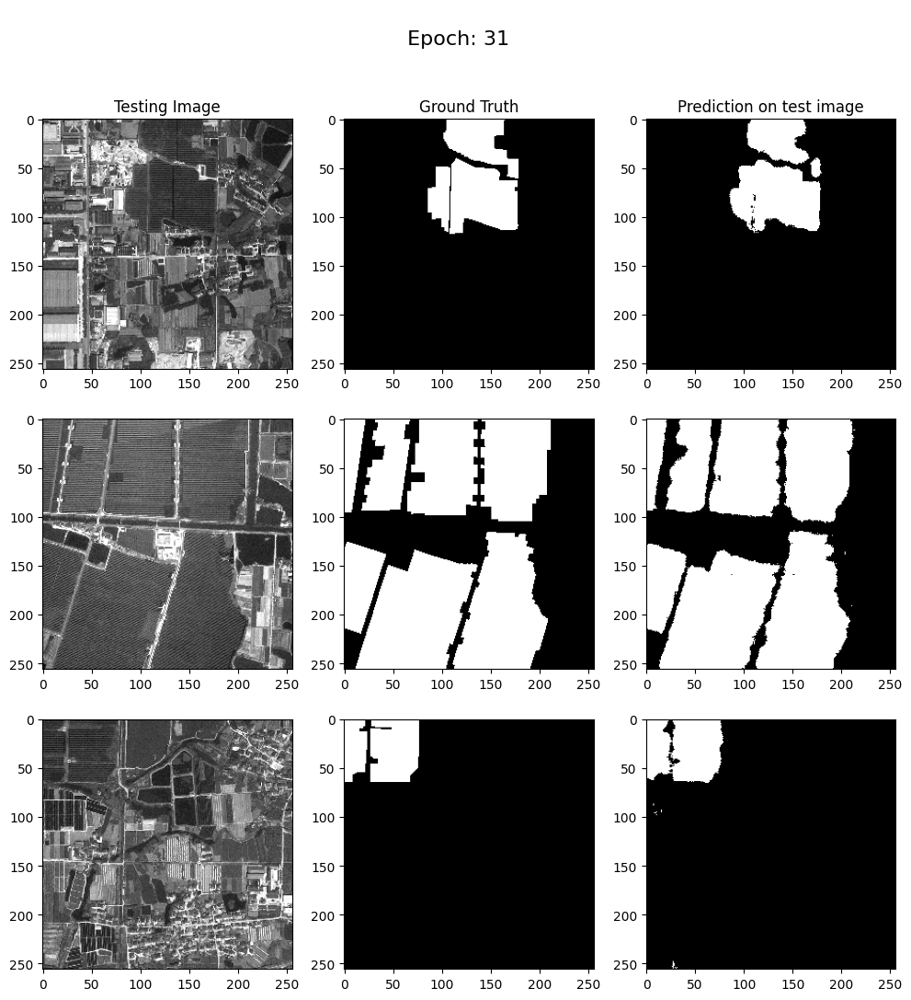


Sample Prediction after epoch 32

43/43 [==============================] - 3s 61ms/step - loss: 0.0467 - accuracy: 0.9830 - val_loss: 0.1455 - val_accuracy: 0.9531
Epoch 33/50
1/1 [==============================] - 0s 25ms/step


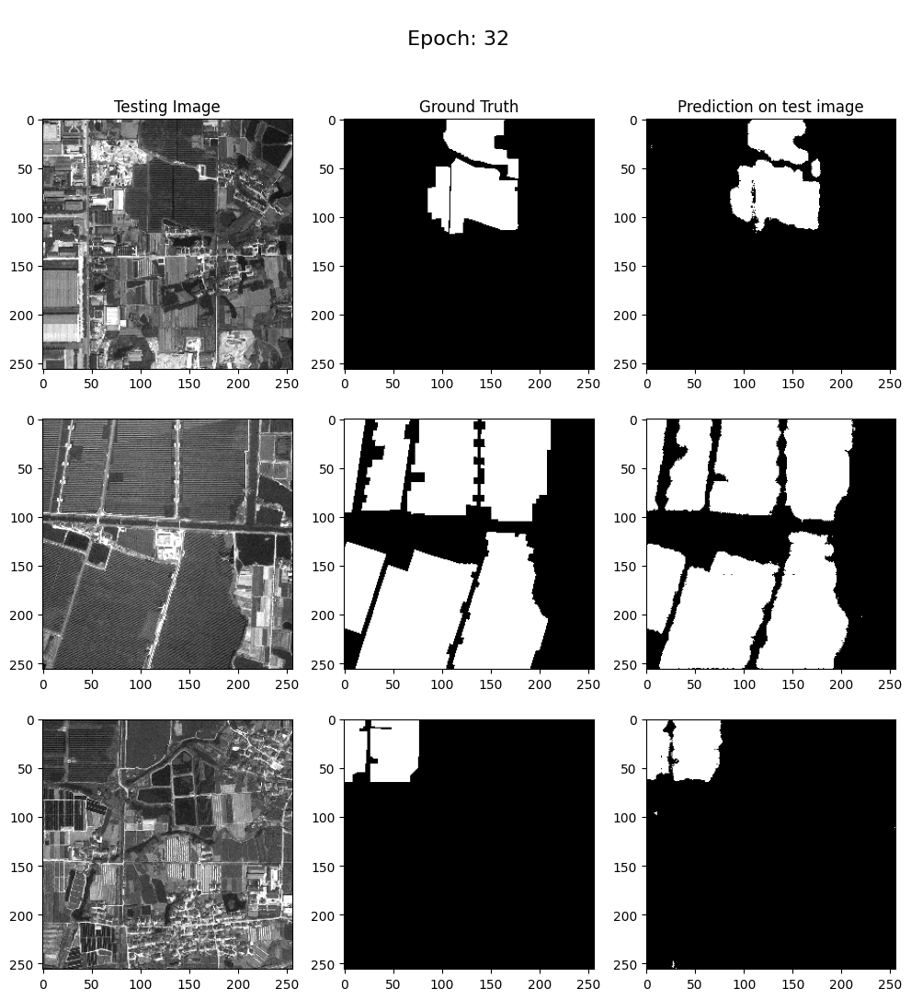


Sample Prediction after epoch 33

43/43 [==============================] - 3s 60ms/step - loss: 0.0441 - accuracy: 0.9839 - val_loss: 0.1524 - val_accuracy: 0.9505
Epoch 34/50
1/1 [==============================] - 0s 29ms/step


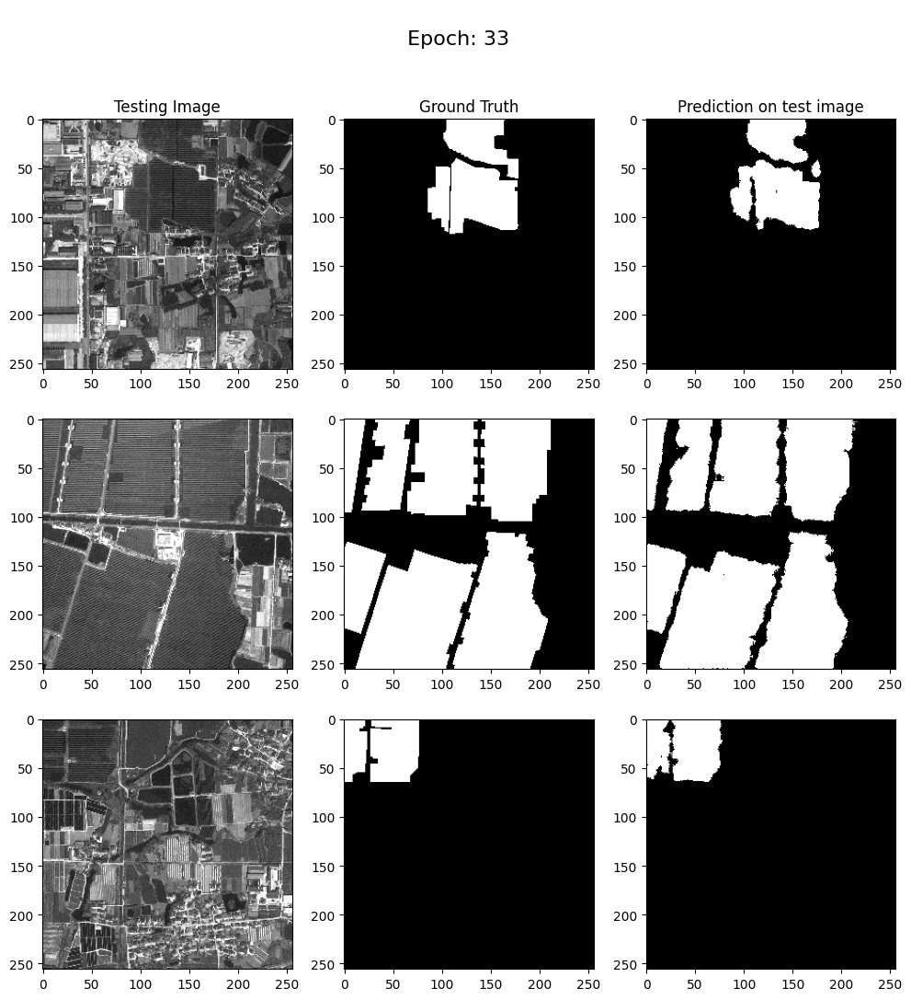


Sample Prediction after epoch 34

43/43 [==============================] - 3s 68ms/step - loss: 0.0440 - accuracy: 0.9839 - val_loss: 0.1676 - val_accuracy: 0.9495
Epoch 35/50
1/1 [==============================] - 0s 26ms/step


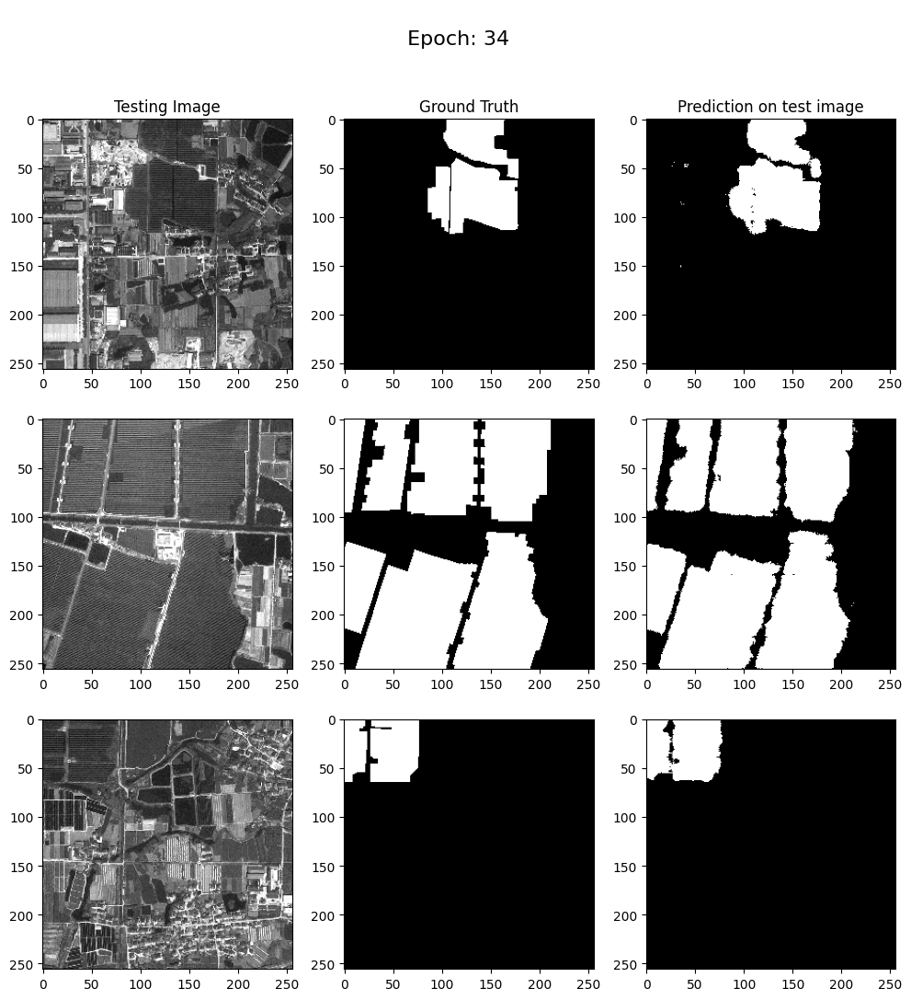


Sample Prediction after epoch 35

43/43 [==============================] - 3s 60ms/step - loss: 0.0435 - accuracy: 0.9840 - val_loss: 0.1454 - val_accuracy: 0.9531
Epoch 36/50
1/1 [==============================] - 0s 26ms/step


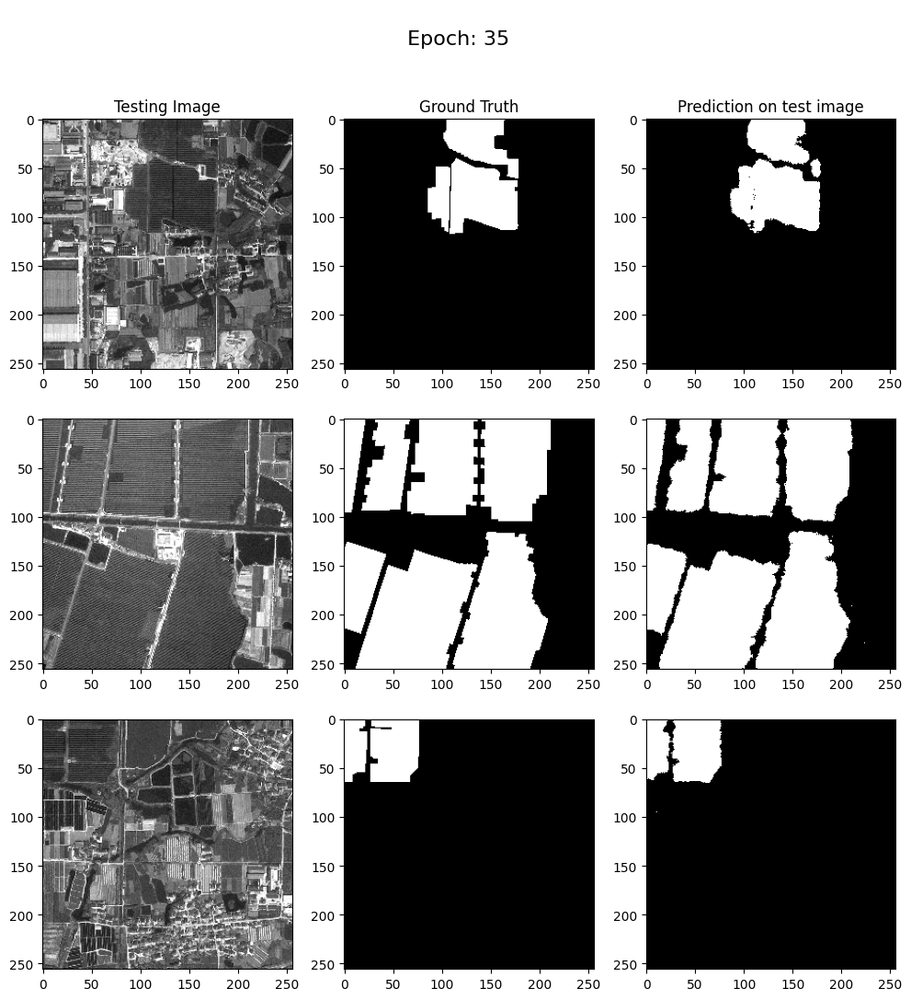


Sample Prediction after epoch 36

43/43 [==============================] - 3s 59ms/step - loss: 0.0413 - accuracy: 0.9848 - val_loss: 0.1521 - val_accuracy: 0.9520
Epoch 37/50
1/1 [==============================] - 0s 26ms/step


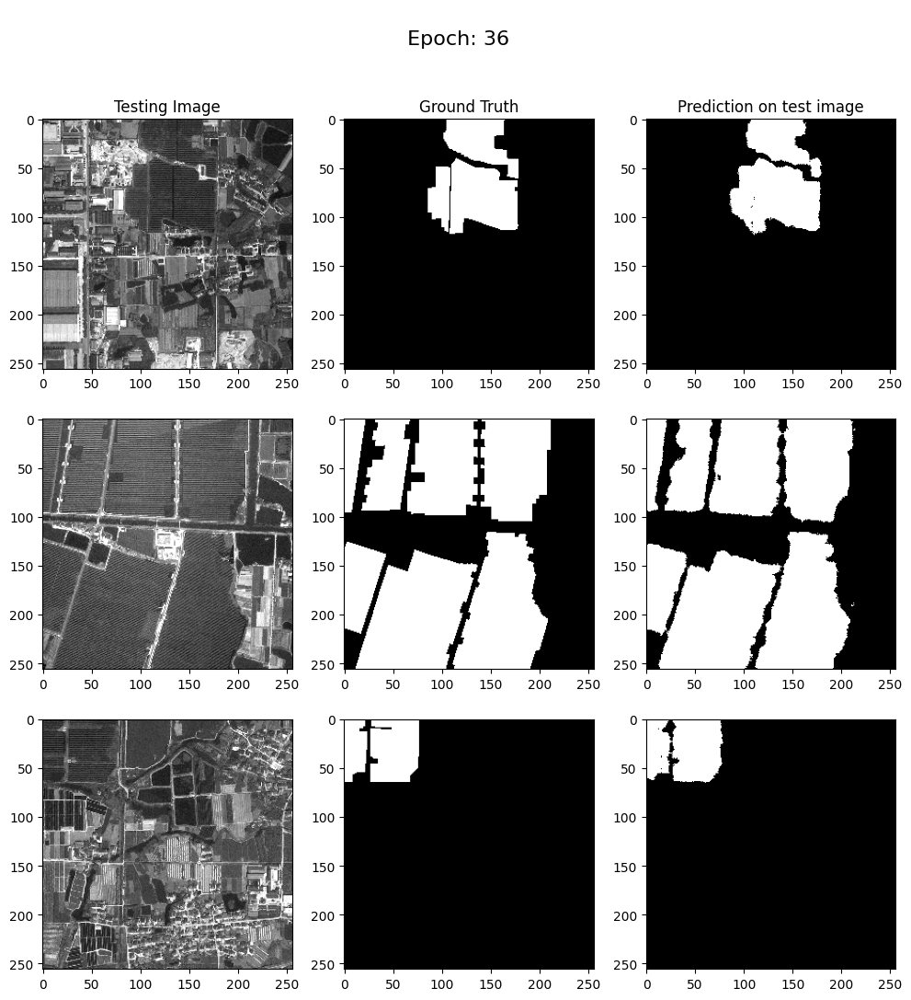


Sample Prediction after epoch 37

43/43 [==============================] - 2s 59ms/step - loss: 0.0397 - accuracy: 0.9855 - val_loss: 0.1513 - val_accuracy: 0.9528
Epoch 38/50
1/1 [==============================] - 0s 27ms/step


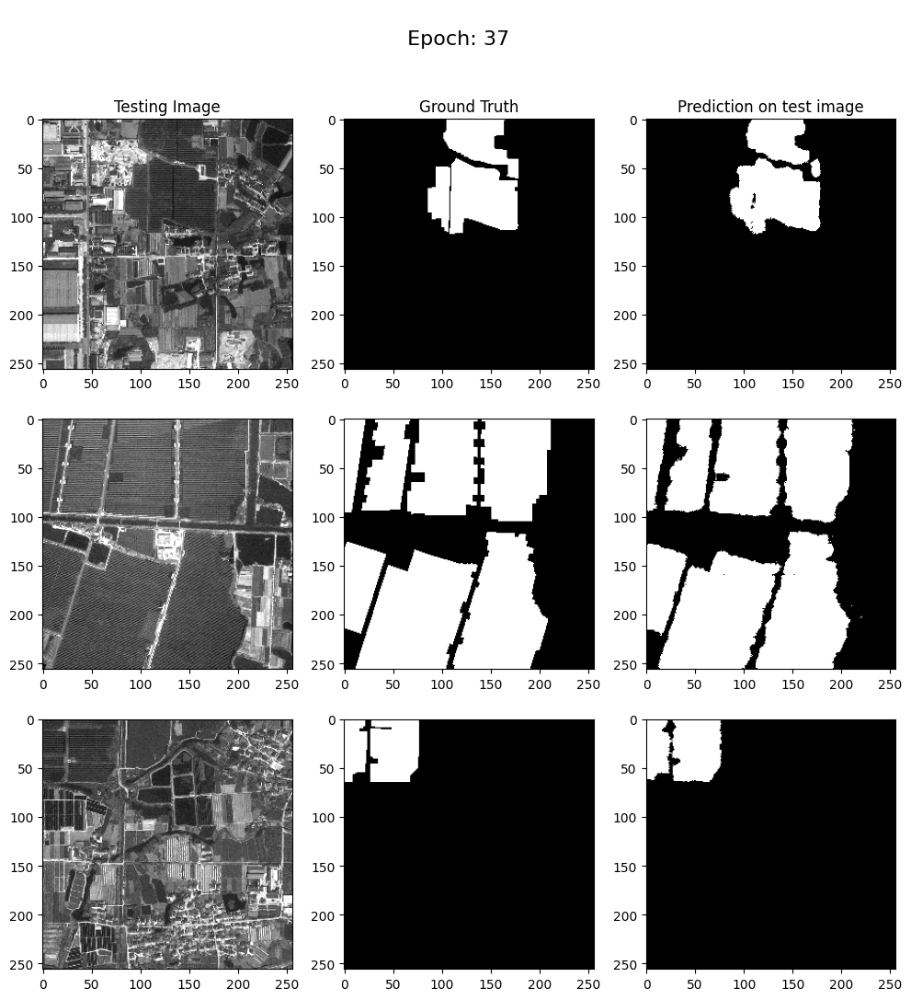


Sample Prediction after epoch 38

43/43 [==============================] - 3s 60ms/step - loss: 0.0385 - accuracy: 0.9859 - val_loss: 0.1501 - val_accuracy: 0.9513
Epoch 39/50
1/1 [==============================] - 0s 29ms/step


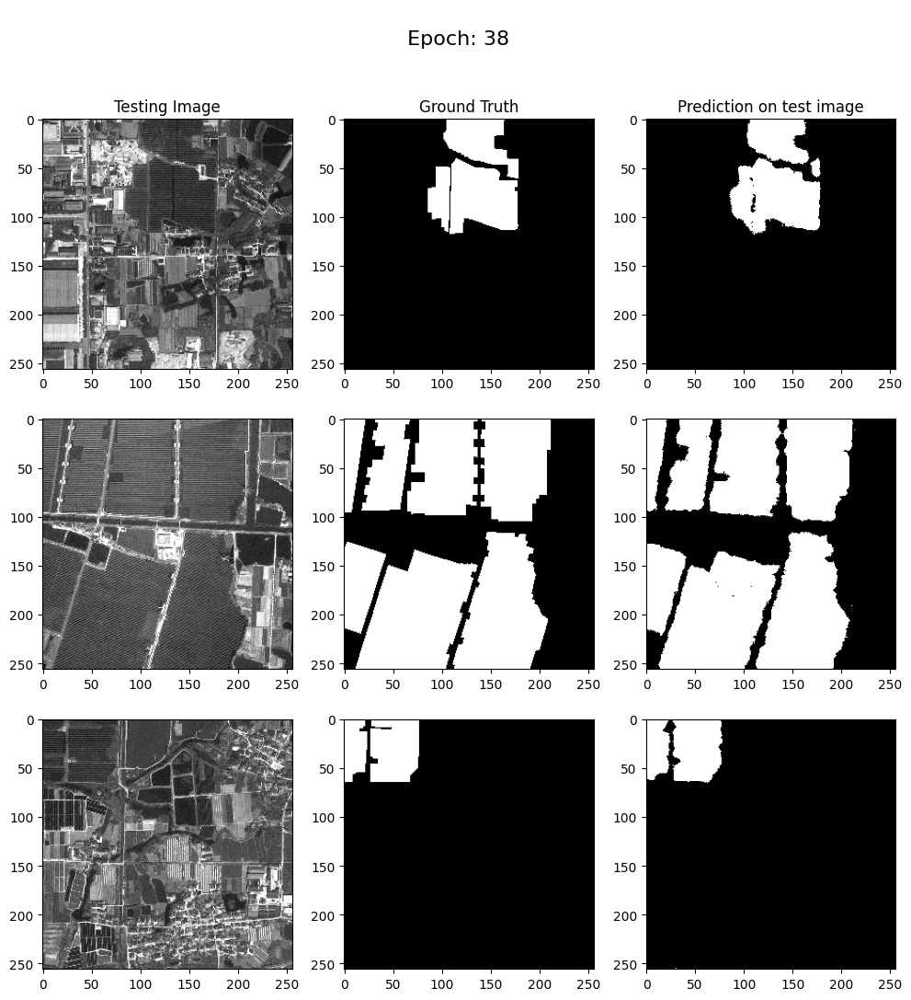


Sample Prediction after epoch 39

43/43 [==============================] - 3s 70ms/step - loss: 0.0368 - accuracy: 0.9863 - val_loss: 0.1693 - val_accuracy: 0.9473
Epoch 40/50
1/1 [==============================] - 0s 27ms/step


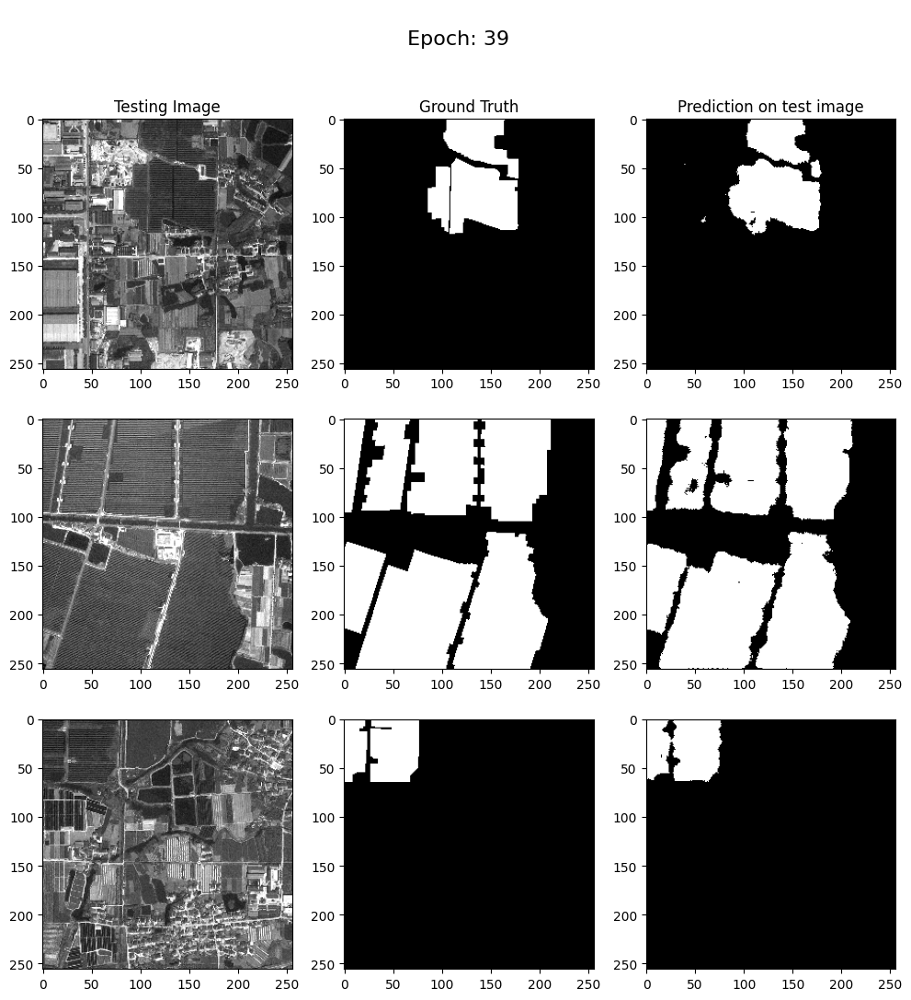


Sample Prediction after epoch 40

43/43 [==============================] - 3s 61ms/step - loss: 0.0413 - accuracy: 0.9845 - val_loss: 0.1695 - val_accuracy: 0.9479
Epoch 41/50
1/1 [==============================] - 0s 26ms/step


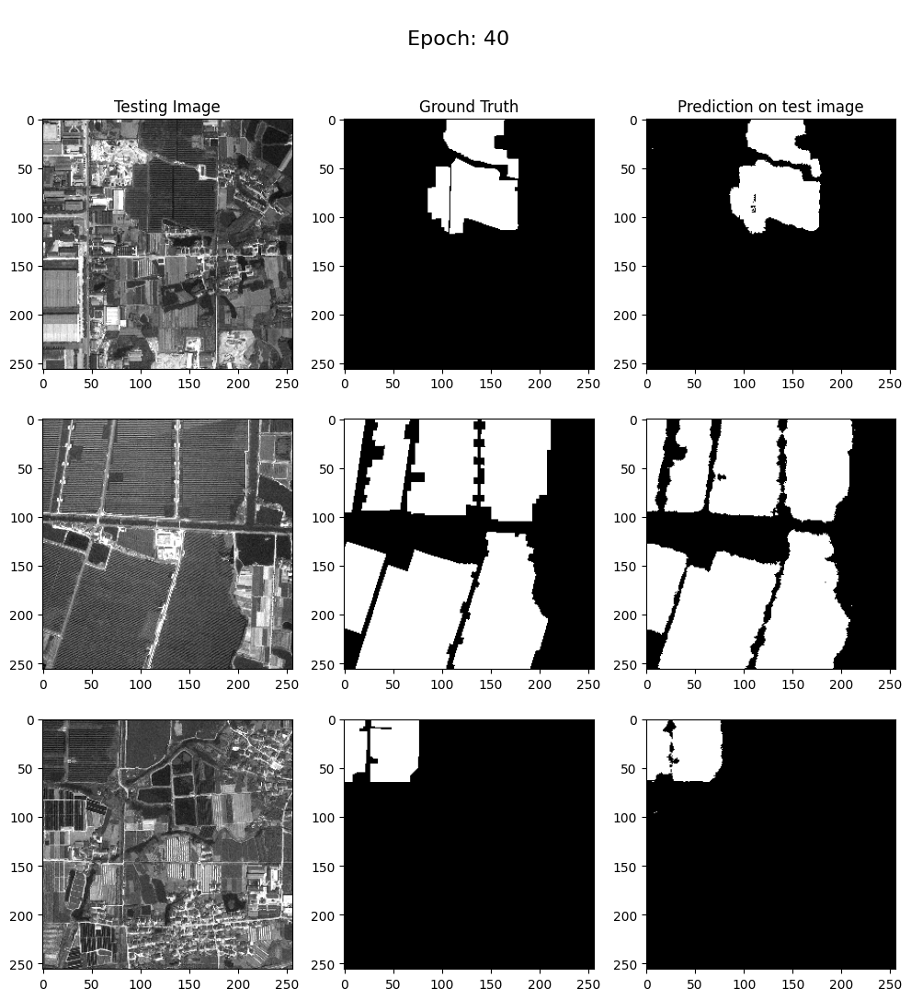


Sample Prediction after epoch 41

43/43 [==============================] - 3s 59ms/step - loss: 0.0397 - accuracy: 0.9852 - val_loss: 0.1673 - val_accuracy: 0.9507
Epoch 42/50
1/1 [==============================] - 0s 24ms/step


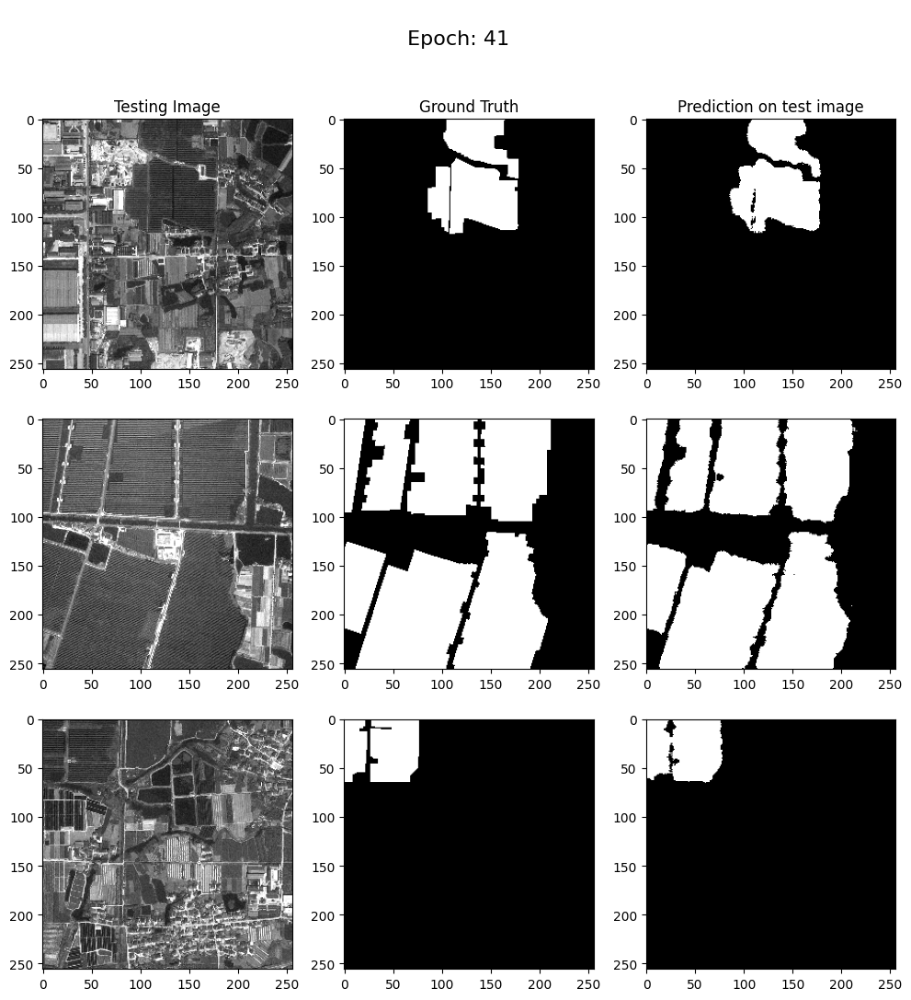


Sample Prediction after epoch 42

43/43 [==============================] - 3s 60ms/step - loss: 0.0346 - accuracy: 0.9871 - val_loss: 0.1666 - val_accuracy: 0.9510
Epoch 43/50
1/1 [==============================] - 0s 26ms/step


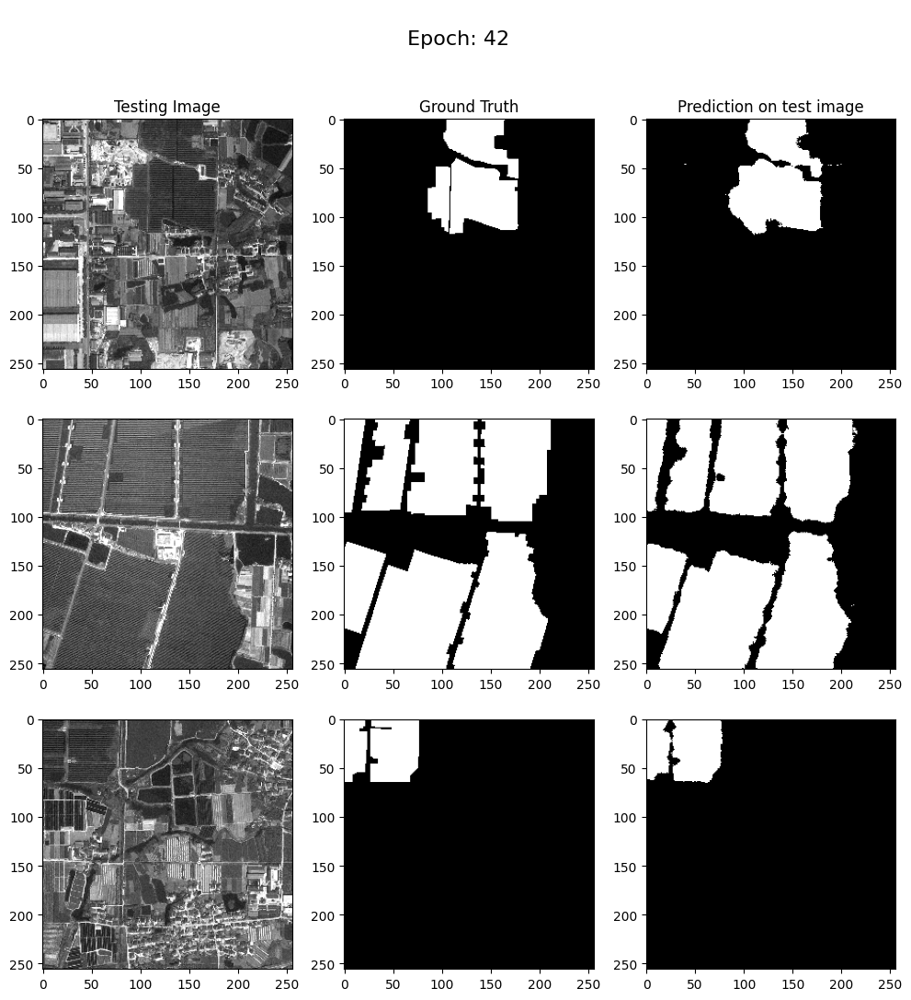


Sample Prediction after epoch 43

43/43 [==============================] - 3s 60ms/step - loss: 0.0359 - accuracy: 0.9866 - val_loss: 0.1752 - val_accuracy: 0.9494
Epoch 44/50
1/1 [==============================] - 0s 29ms/step


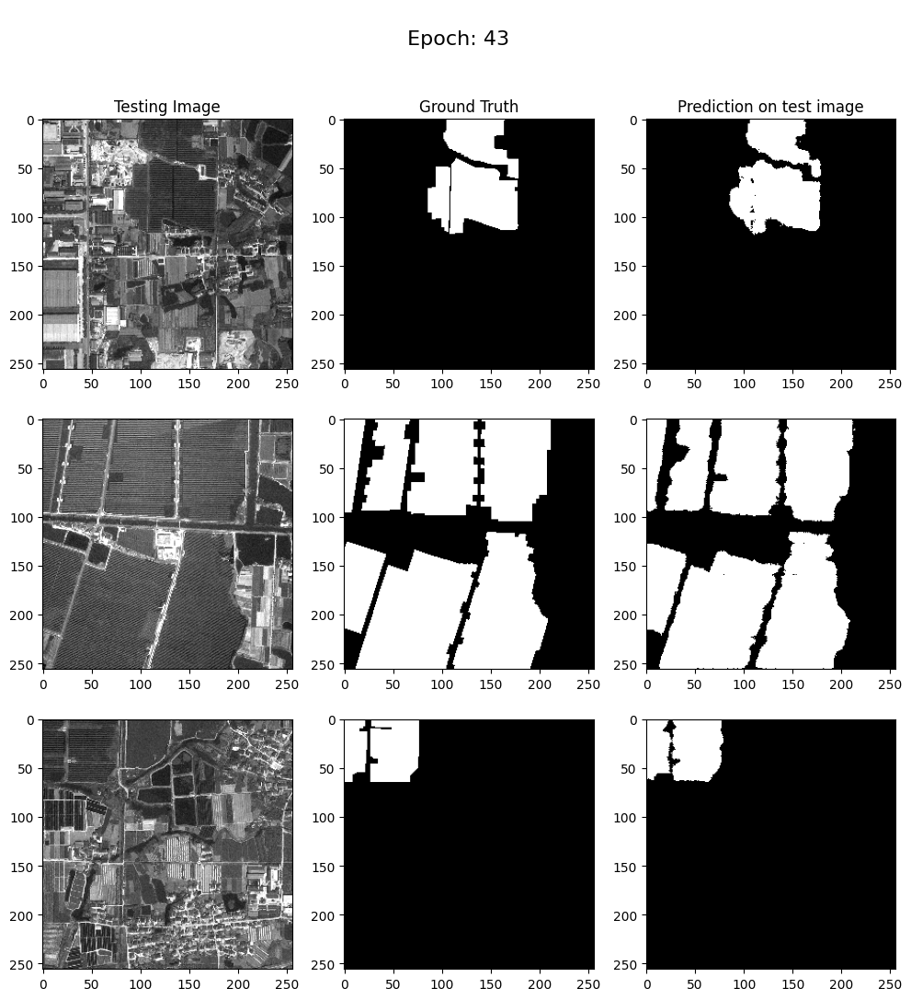


Sample Prediction after epoch 44

43/43 [==============================] - 3s 69ms/step - loss: 0.0351 - accuracy: 0.9869 - val_loss: 0.1642 - val_accuracy: 0.9514
Epoch 45/50
1/1 [==============================] - 0s 28ms/step


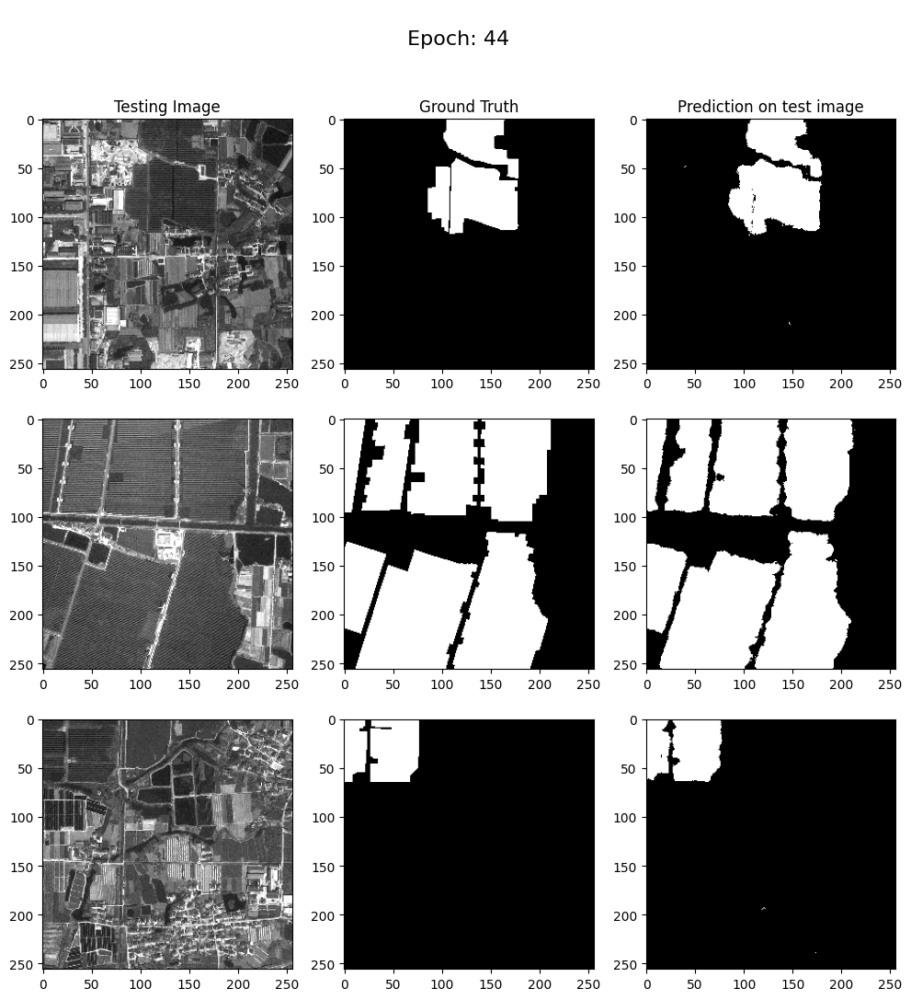


Sample Prediction after epoch 45

43/43 [==============================] - 3s 62ms/step - loss: 0.0364 - accuracy: 0.9865 - val_loss: 0.1447 - val_accuracy: 0.9528
Epoch 46/50
1/1 [==============================] - 0s 27ms/step


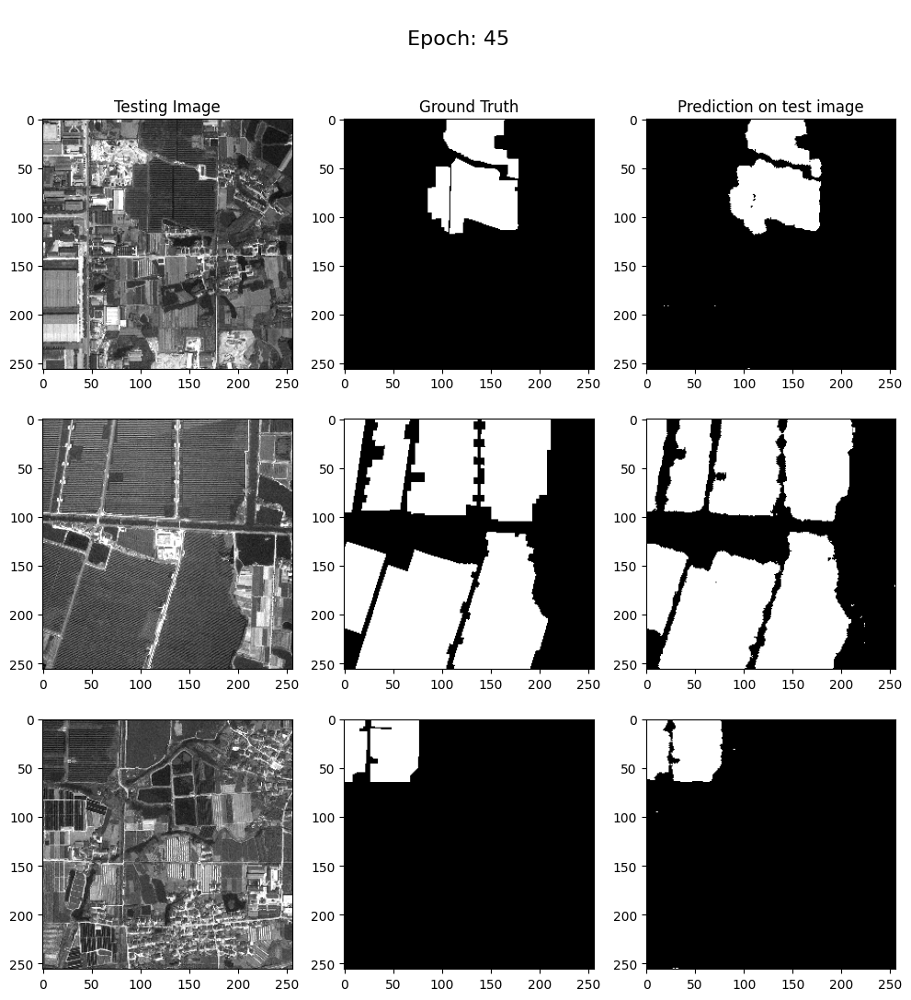


Sample Prediction after epoch 46

43/43 [==============================] - 3s 61ms/step - loss: 0.0344 - accuracy: 0.9871 - val_loss: 0.1488 - val_accuracy: 0.9535
Epoch 47/50
1/1 [==============================] - 0s 26ms/step


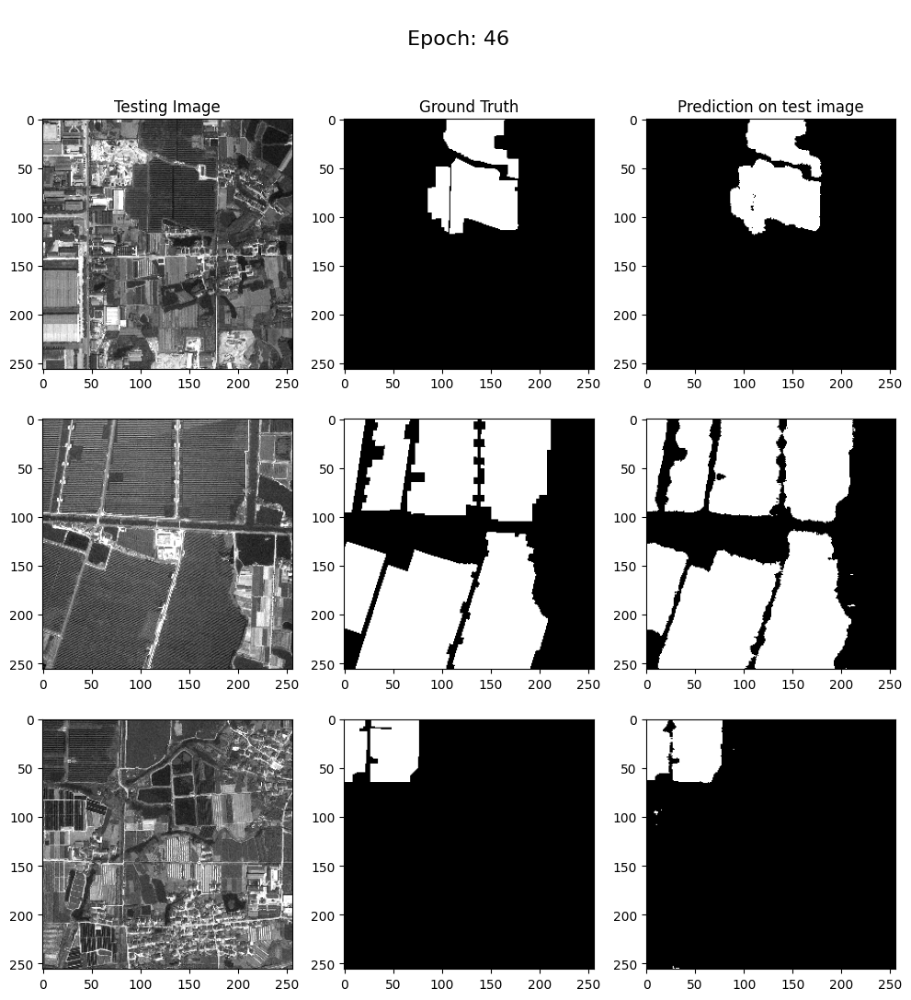


Sample Prediction after epoch 47

43/43 [==============================] - 3s 60ms/step - loss: 0.0337 - accuracy: 0.9874 - val_loss: 0.1684 - val_accuracy: 0.9502
Epoch 48/50
1/1 [==============================] - 0s 29ms/step


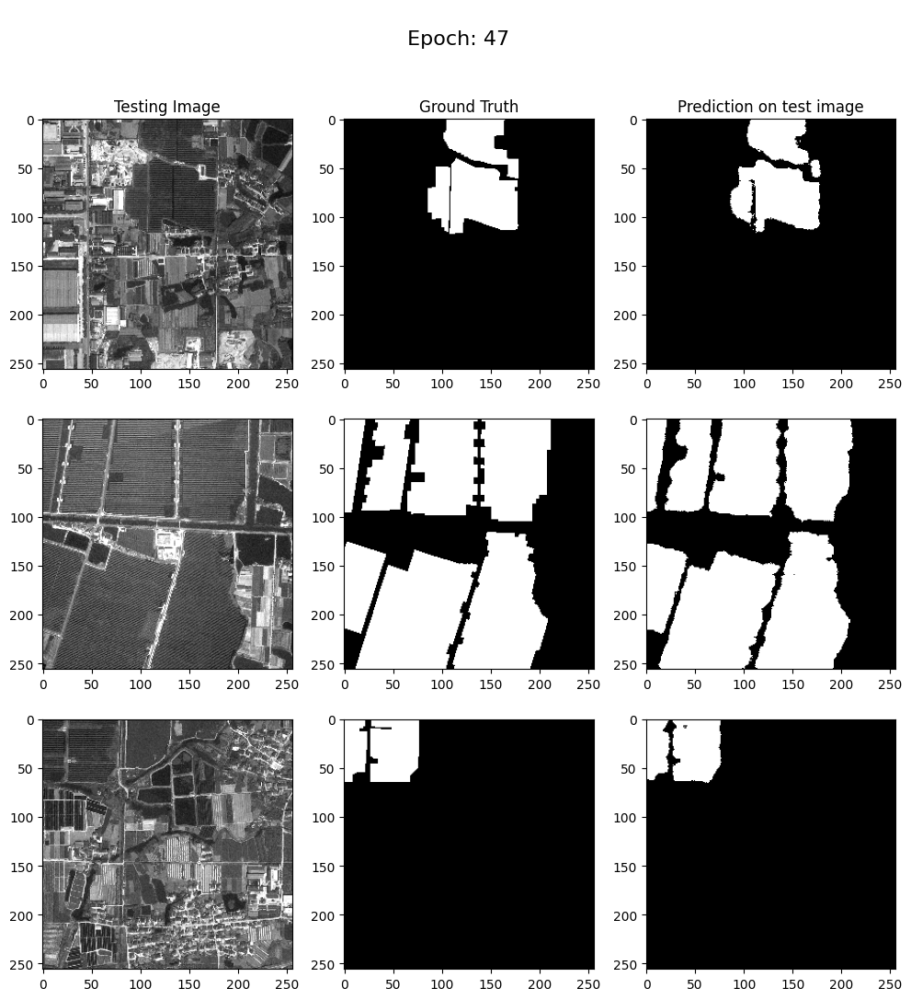


Sample Prediction after epoch 48

43/43 [==============================] - 3s 60ms/step - loss: 0.0323 - accuracy: 0.9878 - val_loss: 0.1804 - val_accuracy: 0.9499
Epoch 49/50
1/1 [==============================] - 0s 27ms/step


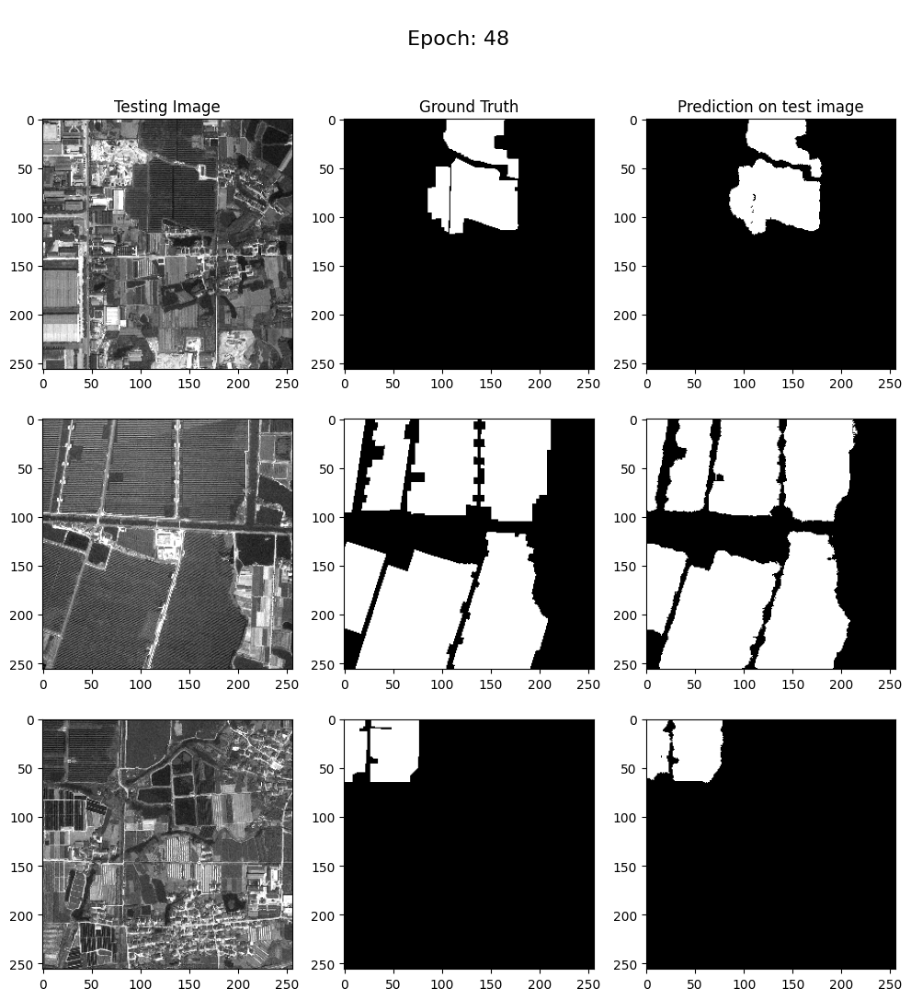


Sample Prediction after epoch 49

43/43 [==============================] - 3s 69ms/step - loss: 0.0329 - accuracy: 0.9876 - val_loss: 0.1581 - val_accuracy: 0.9540
Epoch 50/50
1/1 [==============================] - 0s 27ms/step


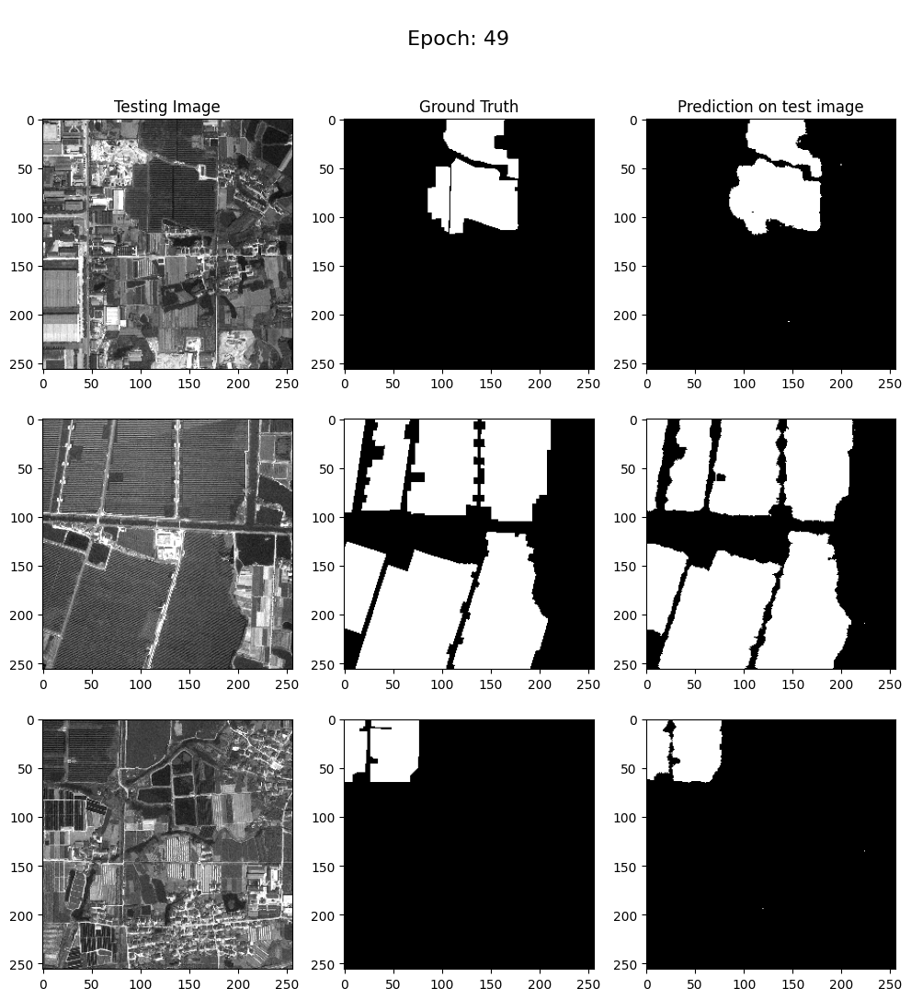


Sample Prediction after epoch 50

43/43 [==============================] - 3s 61ms/step - loss: 0.0322 - accuracy: 0.9878 - val_loss: 0.1461 - val_accuracy: 0.9543


In [ ]:
# Train model and observe gradual improvement of model performance and its convergence
# keep the epochs number to be 50, you will reach over 99% accuracy
EPOCHS = 50
VAL_SUBSPLITS = 5
BATCH_SIZE = 32
VALIDATION_STEPS = len(X_val)//BATCH_SIZE//VAL_SUBSPLITS
STEPS_PER_EPOCH = len(X_train)//BATCH_SIZE

class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        show_predictions(epoch)
        print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

model_history = model.fit(X_train, y_train, epochs=EPOCHS,
                           batch_size = BATCH_SIZE,
                          verbose=1,
                          #steps_per_epoch=STEPS_PER_EPOCH,
                          #validation_steps=VALIDATION_STEPS,
                          validation_data=(X_val, y_val),
                          callbacks=[DisplayCallback()])

**Saving the model**

In [ ]:
# Consider a name for the model
model.save('/content/drive/MyDrive/unet_model_PV08.h5')

In [ ]:
# save the model file in desired path
#!cp '/current/path/unet_model_PV08_99.h5' '/destination/path/unet_model_PV08_99.h5'

**Display accuracy and loss graphs**

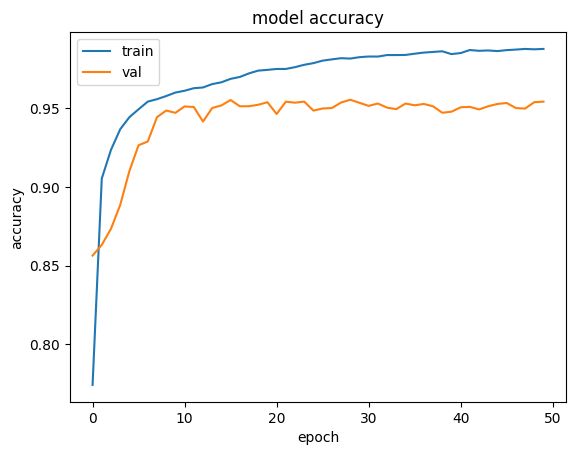

In [ ]:
# Due to "start, stop" approch in the model training, you could see the graphs are shown at the last stages of their improvement, and not from the scratch
plt.plot(model_history.history['accuracy'])
plt.plot(model_history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

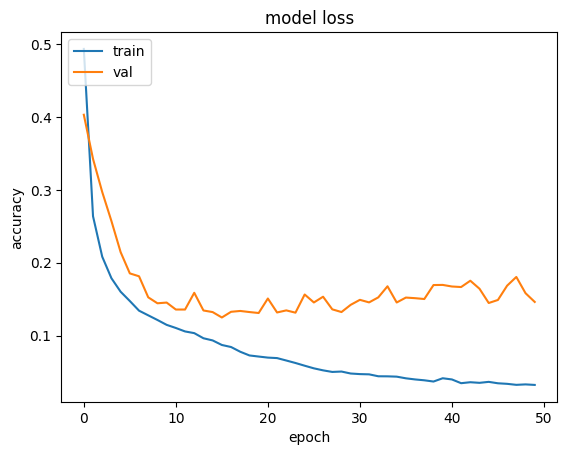

In [ ]:
plt.plot(model_history.history['loss'])
plt.plot(model_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

# **Load the model and test new data**

**Load the trained model**



In [ ]:
# Put model address here
model = load_model('/content/drive/MyDrive/unet_model_PV08.h5')

**Choose either Internet or your directory for picking image**

**Your directory**

In [ ]:
# Put image address in your directory
image = Image.open('/content/drive/MyDrive/images_PV08/PV08_340238_1175975.bmp')

**Internet image**

In [ ]:
# Image_url
# As it has been described in Test Report, only images similar to dataset are expetecd to be suitably masked
image_url = 'put/your/url/here'

# Define the path where you want to save the downloaded image
save_path = '/content/images/image.jpg'

# Create the necessary directories if they don't exist
os.makedirs(os.path.dirname(save_path), exist_ok=True)

# Download the image using urllib
urllib.request.urlretrieve(image_url, save_path)

# Open the downloaded image using PIL
image = Image.open(save_path)

**Process the directory Image/ Internet Image to display solar panel locations in rectangles**

1/1 [==============================] - 0s 196ms/step


(-0.5, 255.5, 255.5, -0.5)

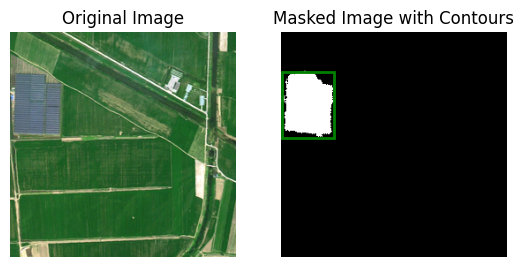

In [ ]:
# Prepare the image
resized_image = image.resize((256, 256))
image_array = np.array(resized_image)
norm_image = image_array / 255.0
norm_image_2 = np.expand_dims(norm_image, axis=0)

# Predict
prediction = model.predict(norm_image_2)
segmentation_mask = np.argmax(prediction, axis=-1)
cmap = plt.get_cmap('gray', 2)                                # Define the color map based on the number of classes
segmentation_mask_rgb = cmap(segmentation_mask[0])[:, :, :3]

# Finding contours
image_data = np.array(norm_image)
mask_data = np.array(segmentation_mask_rgb)

# Convert image and mask data to image file formats in memory
_, image_buffer = cv2.imencode('.jpg', image_data)
_, mask_buffer = cv2.imencode('.jpg', mask_data)

# Read image and mask data from memory
image = cv2.imdecode(image_buffer, cv2.IMREAD_COLOR)
mask = cv2.imdecode(mask_buffer, cv2.IMREAD_GRAYSCALE)

# Find contours in the mask
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Iterate over the contours and draw rectangles
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    # Draw a rectangle around the contour
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

# Convert BGR image to RGB for display with matplotlib
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


fig, axes = plt.subplots(1, 2)

# Display the original image
axes[0].imshow(resized_image)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Display the masked image with contours

axes[1].imshow(segmentation_mask_rgb)
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    rect = plt.Rectangle((x, y), w, h, linewidth=2, edgecolor='g', facecolor='none')
    axes[1].add_patch(rect)
axes[1].set_title('Masked Image with Contours')
axes[1].axis('off')
